This blog describes how to prcoedurally generate fractal-like Joshua Trees using `matplotlib` - something exceedingly unuseful. It is split into five broad sections:
1. Review of "classic" fractal trees
2. Parameter exploration & algorithm tweaks
3. Textures
4. Putting it all together
5. Forests & scenes

In [1]:
import os
import sys
import copy
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from matplotlib.collections import PatchCollection
%matplotlib inline

## 1 - Review of fracal tree generation

References:
1. [The "hello world" example from Rosetta Code](https://rosettacode.org/wiki/Fractal_tree#Python)
2. [Interactive tree generator 1](https://github.com/hanskellner/FractalTree2DJS)
3. [Interactive tree generator 2](https://someuser-321.github.io/TreeGenerator/)
4. [Interactive tree generator 3](https://filosophy.org/projects/trees/)

Our most basic example is as follows, adapted from (1). We start with a vertical (represented by the initial angle of -90 degrees) line segment of length `INITIAL_LENGTH`. At the top of this line segment, we branch out two more line segments, with angles rotated by `ANGLE_CHANGE` degrees in either direction, and the length decreased by a factor of `LENGTH_CHANGE`. This process is repeated `DEPTH` times:

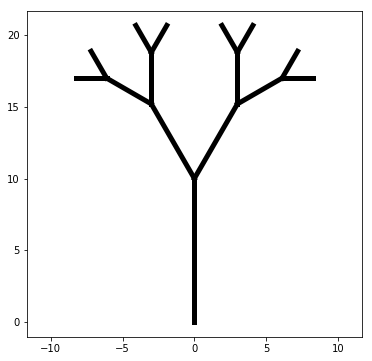

In [277]:
def drawTree(x1, y1, angle, length, depth):
    if depth:
        # Calculate end position of segment
        x2 = x1 + (np.cos(np.radians(angle)) * length)
        y2 = y1 - (np.sin(np.radians(angle)) * length)
        # Plot
        plt.plot((x1, x2), (y1, y2), 'k-', lw='5')
        # Draw two more branches
        drawTree(x2, y2, angle-ANGLE_CHANGE, length*LENGTH_CHANGE, depth-1)
        drawTree(x2, y2, angle+ANGLE_CHANGE, length*LENGTH_CHANGE, depth-1)

# Constants
DEPTH = 4
ANGLE_CHANGE = 30
LENGTH_CHANGE = 0.6
INITIAL_LENGTH = 10

# Draw
plt.figure(figsize=(6,6))
drawTree(0, 0, -90, INITIAL_LENGTH, DEPTH)
plt.axis('equal')
plt.show()

What we get is a nice symmetric tree, with four (`DEPTH`) distinct branch segments. The simplest modification to this basic method is to introduce some randomness to both the angles and lengths (from here on in, we'll also seed each function with a number so the results are directly reproducible). To do this, we simply allow them to both to fluctuate by some proportion of themselves (`LENGTH_VARY_PROP` and `ANGLE_VARY_PROP`):

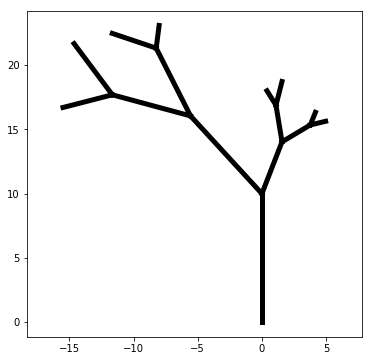

In [322]:
def drawTree(x1, y1, angle, length, depth):
    if depth:
        # Calculatre end position of segment
        x2 = x1 + np.cos(np.radians(angle)) * length
        y2 = y1 - np.sin(np.radians(angle)) * length
        # Plot
        plt.plot((x1, x2), (y1, y2), 'k-', lw=5)
        # Randomise the angle & length changes
        rnd = np.random.random(4) - 0.5
        l1 = LENGTH_CHANGE + (rnd[0] * LENGTH_CHANGE * LENGTH_VARY_PROP)
        l2 = LENGTH_CHANGE + (rnd[1] * LENGTH_CHANGE * LENGTH_VARY_PROP)
        a1 = ANGLE_CHANGE  + (rnd[2] * ANGLE_CHANGE  * ANGLE_VARY_PROP)
        a2 = ANGLE_CHANGE  + (rnd[3] * ANGLE_CHANGE  * ANGLE_VARY_PROP)
        # Draw two more branches
        drawTree(x2, y2, angle+a1, length*l1, depth-1)
        drawTree(x2, y2, angle-a2, length*l2, depth-1)

# Seed
seed = 5
np.random.seed(seed)

# Constants
DEPTH = 4
ANGLE_CHANGE = 30
LENGTH_CHANGE = 0.6
INITIAL_LENGTH = 10
LENGTH_VARY_PROP = 1.0
ANGLE_VARY_PROP = 1.0

# Draw
plt.figure(figsize=(6,6))
drawTree(0, 0, -90, INITIAL_LENGTH, DEPTH)
plt.axis('equal')
plt.show()

Immediately we can see this is starting to look much more natural. The last major modification we will make is to set the probability of a split (`SPLIT_PROB`). This means we should get less symmetry in terms of the branches. At this stage, we'll also increase the number of iterations (`DEPTH`) since it will make more realistic looking trees:

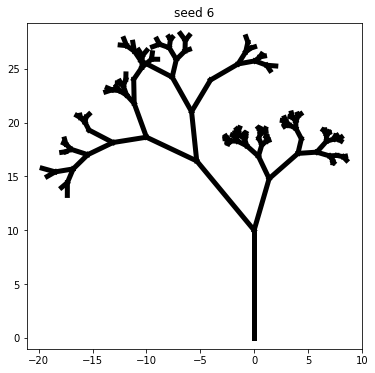

In [330]:
def drawTree(x1, y1, angle, length, depth):
    if depth:
        # Calculatre end position of segment
        x2 = x1 + np.cos(np.radians(angle)) * length
        y2 = y1 - np.sin(np.radians(angle)) * length
        # Plot
        plt.plot((x1, x2), (y1, y2), 'k-', lw=5)
        # Randomise the angle & length changes
        rnd1 = np.random.random(4) - 0.5
        l1 = LENGTH_CHANGE + (rnd1[0] * LENGTH_CHANGE * LENGTH_VARY_PROP)
        l2 = LENGTH_CHANGE + (rnd1[1] * LENGTH_CHANGE * LENGTH_VARY_PROP)
        a1 = ANGLE_CHANGE  + (rnd1[2] * ANGLE_CHANGE  * ANGLE_VARY_PROP)
        a2 = ANGLE_CHANGE  + (rnd1[3] * ANGLE_CHANGE  * ANGLE_VARY_PROP)
        # Draw two more branches
        rnd2 = np.random.random(2)
        if rnd2[0] < SPLIT_PROB: drawTree(x2, y2, angle-a1, length*l1, depth-1)
        if rnd2[1] < SPLIT_PROB: drawTree(x2, y2, angle+a2, length*l2, depth-1)

# Seed
seed = 6
np.random.seed(seed)

# Constants
DEPTH = 8
ANGLE_CHANGE = 30
LENGTH_CHANGE = 0.6
INITIAL_LENGTH = 10
LENGTH_VARY_PROP = 1.0
ANGLE_VARY_PROP = 1.0
SPLIT_PROB = 0.9

# Draw
plt.figure(figsize=(6,6))
drawTree(0, 0, -90, INITIAL_LENGTH, DEPTH)
plt.axis('equal')
plt.title('seed {}'.format(seed))
plt.show()

Things are looking pretty good at this stage: we have random angle & length variation, as well as some branches "missing" giving a more natural variation. Before we wrap up this review section, it's worth touching briefly on the aesthetics. The trees so far have been drawn with constant width, and by simply reducing this width each iteration, it can make much nicer looking trees (for this we use the `linewidth` or `lw` argument in `plt.plot` - this isn't too versatile since it is specified in units of "points", but it will be changed anyway in Section 2).

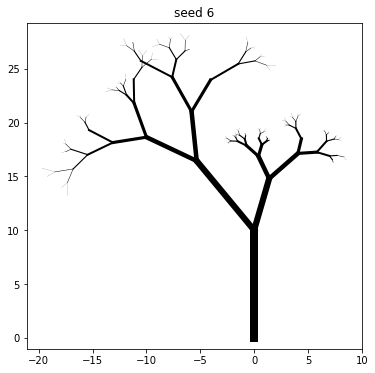

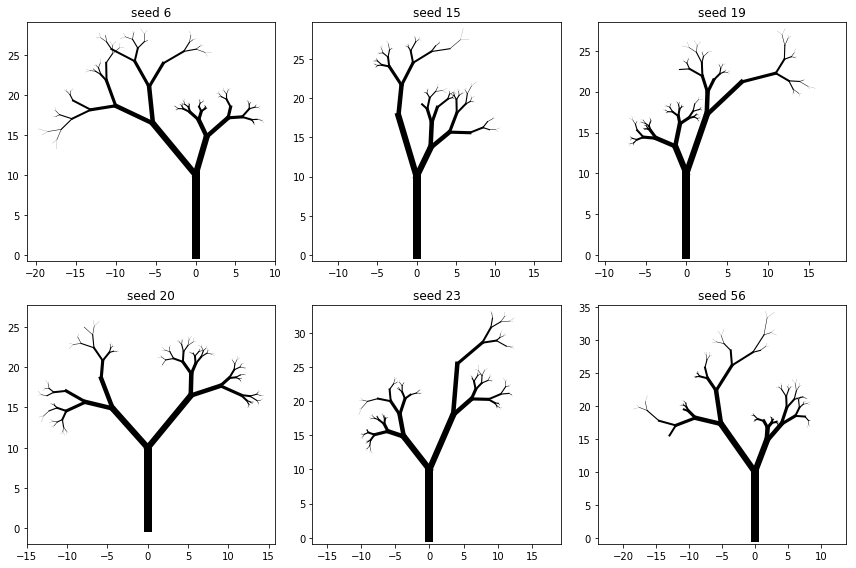

In [341]:
def drawTree(x1, y1, angle, length, depth):
    if depth:
        # Calculatre end position of segment
        x2 = x1 + np.cos(np.radians(angle)) * length
        y2 = y1 - np.sin(np.radians(angle)) * length
        # Plot
        w = (depth**2)/8
        plt.plot((x1, x2), (y1, y2), 'k-', lw=w)
        # Randomise the angle & length changes
        rnd1 = np.random.random(4) - 0.5
        l1 = LENGTH_CHANGE + (rnd1[0] * LENGTH_CHANGE * LENGTH_VARY_PROP)
        l2 = LENGTH_CHANGE + (rnd1[1] * LENGTH_CHANGE * LENGTH_VARY_PROP)
        a1 = ANGLE_CHANGE  + (rnd1[2] * ANGLE_CHANGE  * ANGLE_VARY_PROP)
        a2 = ANGLE_CHANGE  + (rnd1[3] * ANGLE_CHANGE  * ANGLE_VARY_PROP)
        # Draw two more branches
        rnd2 = np.random.random(2)
        if rnd2[0] < SPLIT_PROB: drawTree(x2, y2, angle-a1, length*l1, depth-1)
        if rnd2[1] < SPLIT_PROB: drawTree(x2, y2, angle+a2, length*l2, depth-1)

# Draw one tree
seed = 6
np.random.seed(seed)
plt.figure(figsize=(6,6))
drawTree(0, 0, -90, INITIAL_LENGTH, DEPTH)
plt.axis('equal')
plt.title('seed {}'.format(seed))

# Plot a few trees with interesting seeds
plt.figure(figsize=(12,8))
seeds = [6, 15, 19, 20, 23, 56]
for i, seed in enumerate(seeds):
    np.random.seed(seed)
    plt.subplot(2,3,i+1)
    drawTree(0, 0, -90, INITIAL_LENGTH, DEPTH)
    plt.axis('equal')
    plt.title('seed {}'.format(seed))
plt.tight_layout()

plt.show()

Before we wrap up this section, we should replace the line segments drawn so far with rectangles (using `matplotlib.patches.Rectangle`). This will require a few boring code changes to the tree routine (mainly to set the width, and rotate the rectangle), but produce similar results. Additionally we will move out all the constants so they can be passed in as a dictionary, for easier tweaking.

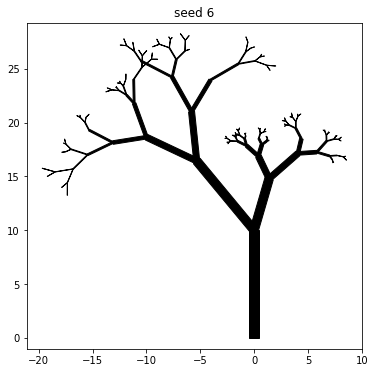

In [771]:
C = {'x0':0,
    'y0':0,
    'INITIAL_LENGTH':10,
    'LENGTH_CHANGE':0.6,
    'LENGTH_VARY_PROP':1.0,
    'INITIAL_ANGLE':-90,
    'ANGLE_CHANGE':30,
    'ANGLE_VARY_PROP':1.0,
    'SPLIT_PROB':0.9,
    'INITIAL_WIDTH':1.0,
    'WIDTH_CHANGE':0.8,
    'DEPTH':8}

def drawTree(x1, y1, angle, length, width, depth, C):
    if depth:
        # Calculatre end position of segment
        x2 = x1 + np.cos(np.radians(angle)) * length
        y2 = y1 - np.sin(np.radians(angle)) * length
        # Plot
        w = (depth**2)/8
        rect = Rectangle((x1-(width/2), y1), width, length, color='k')
        # Rotate using this transform (rather than the angle parameter in Rectangle)
        # Because it rotates around the midpoint this way, rather than the corner
        t = mpl.transforms.Affine2D().rotate_deg_around(x1,y1,-angle-90) + plt.gca().transData
        rect.set_transform(t)
        plt.gca().add_patch(rect)
        # Randomise the angle & length changes
        rnd1 = np.random.random(4) - 0.5
        l1 = C['LENGTH_CHANGE'] + (rnd1[0] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        l2 = C['LENGTH_CHANGE'] + (rnd1[1] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        a1 = C['ANGLE_CHANGE']  + (rnd1[2] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        a2 = C['ANGLE_CHANGE']  + (rnd1[3] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        # Draw two more branches
        rnd2 = np.random.random(2)
        if rnd2[0] < C['SPLIT_PROB']: drawTree(x2, y2, angle-a1, length*l1, width*C['WIDTH_CHANGE']*(depth/C['DEPTH']), depth-1, C)
        if rnd2[1] < C['SPLIT_PROB']: drawTree(x2, y2, angle+a2, length*l2, width*C['WIDTH_CHANGE']*(depth/C['DEPTH']), depth-1, C)


# Draw one tree
seed = 6
np.random.seed(seed)
plt.figure(figsize=(6,6))
drawTree(C['x0'], C['y0'], C['INITIAL_ANGLE'], C['INITIAL_LENGTH'], C['INITIAL_WIDTH'], C['DEPTH'], C)
plt.axis('equal')
plt.title('seed {}'.format(seed))
plt.show()

The equation used here to reduce the width of the rectangles may be modified later, but the main reason for doing this is to make a more generalised function so we can modify things more readily if we need to (even if the results don't look as pretty as the nice single lines).

So now we have a nice tree generation routine, we can move on to exploring the parameter space to see what combinations of parameters create realistic-looking Joshua Trees, and what (if any) modifications need to be made to this initial approach.

## 2 - Parameter exploration

Before playing with any more code, we really need to inspect some real Joshua Trees and try and describe how they behave, in terms of the parameters of the model we have built up so far. Likely we will end up with a number of different sets of parameters, that best describe different styles of trees.  The general approach will be, for a number of classic Joshua Tree photographs:

1. Describe it qualitatively in terms of our model parameters
2. Take a guess at which constants might work
3. Generate a lot of examples to see how it works
4. Rinse and repeat (this step, essentially trial & error, won't be shown)

### Sample sources

1. https://www.axios.com/government-shutdown-national-parks-joshua-trees-98350e1b-496b-4508-a0d5-45bd4074e42b.html
2. https://www.smithsonianmag.com/smart-news/californias-joshua-trees-are-under-threat-180959991/
3. https://gearpatrol.com/2015/06/30/joshua-tree-travel-guide/
4. https://gearpatrol.com/2015/06/30/joshua-tree-travel-guide/
5. https://www.washingtonpost.com/nation/2019/01/11/travesty-this-nation-people-are-destroying-joshua-trees-joshua-tree-national-park
6. https://backroadplanet.com/best-hikes-joshua-tree-day-trip/
7. https://www.palmspringslife.com/rock-around-the-clock/
8. http://www.ghumr.com/joshua-tree-national-park-flintstone-land/
9. http://www.ghumr.com/joshua-tree-national-park-flintstone-land/
10. https://www.nationalgeographic.com/travel/national-parks/joshua-tree-national-park/
11. https://en.wikipedia.org/wiki/Yucca_brevifolia#/media/File:JoshuaTreesMexico.jpg
12. https://www.tripsavvy.com/joshua-tree-national-park-4116596
13. https://www.tripsavvy.com/joshua-tree-national-park-4116596
14. http://cannundrum.blogspot.com/2010/07/joshua-tree.html

|1|2|3|4|5|6|
|-|-|-|-|-|-|
| 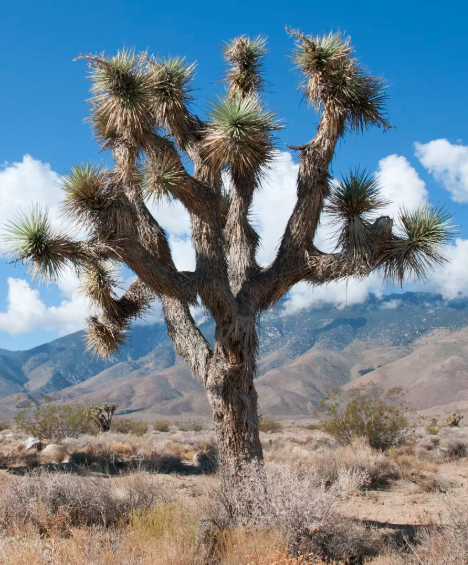 | 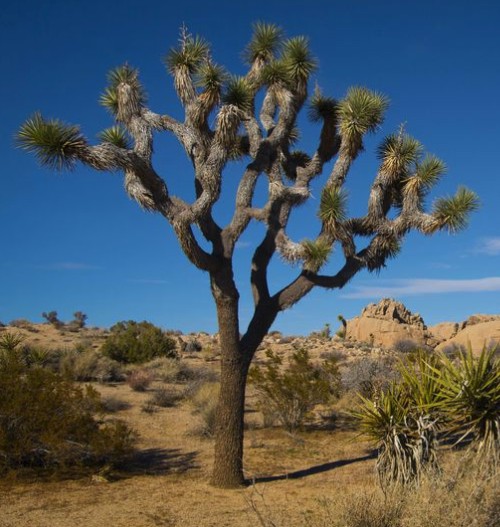 |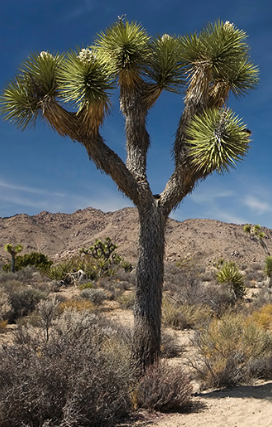 | 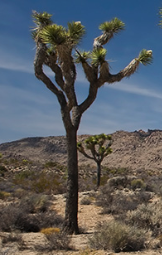 | 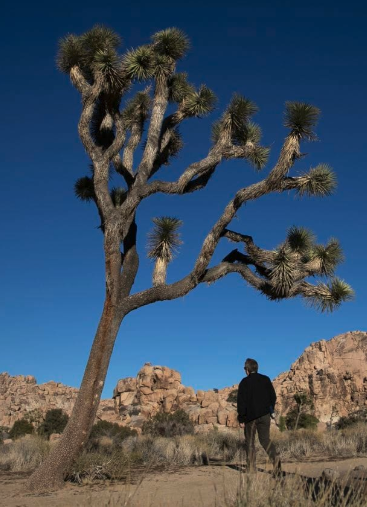 | 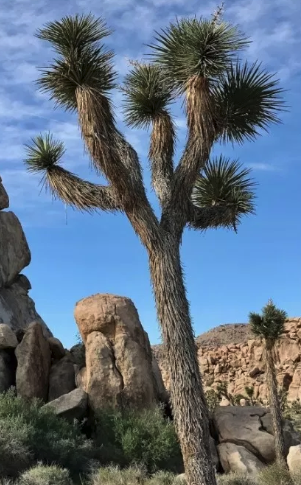
|7|8|9|10|11|12|
|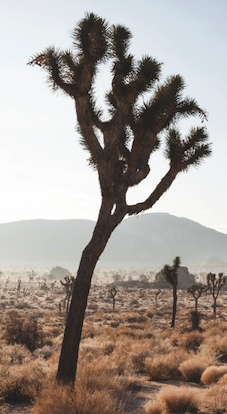 | 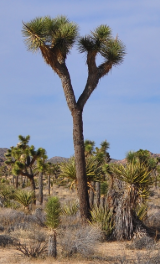 | 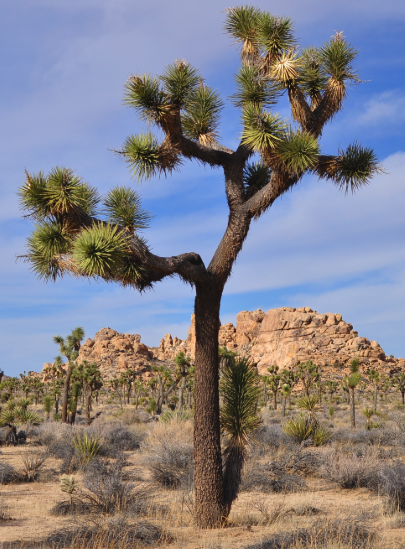 | 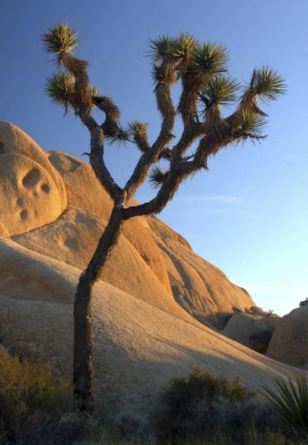 | 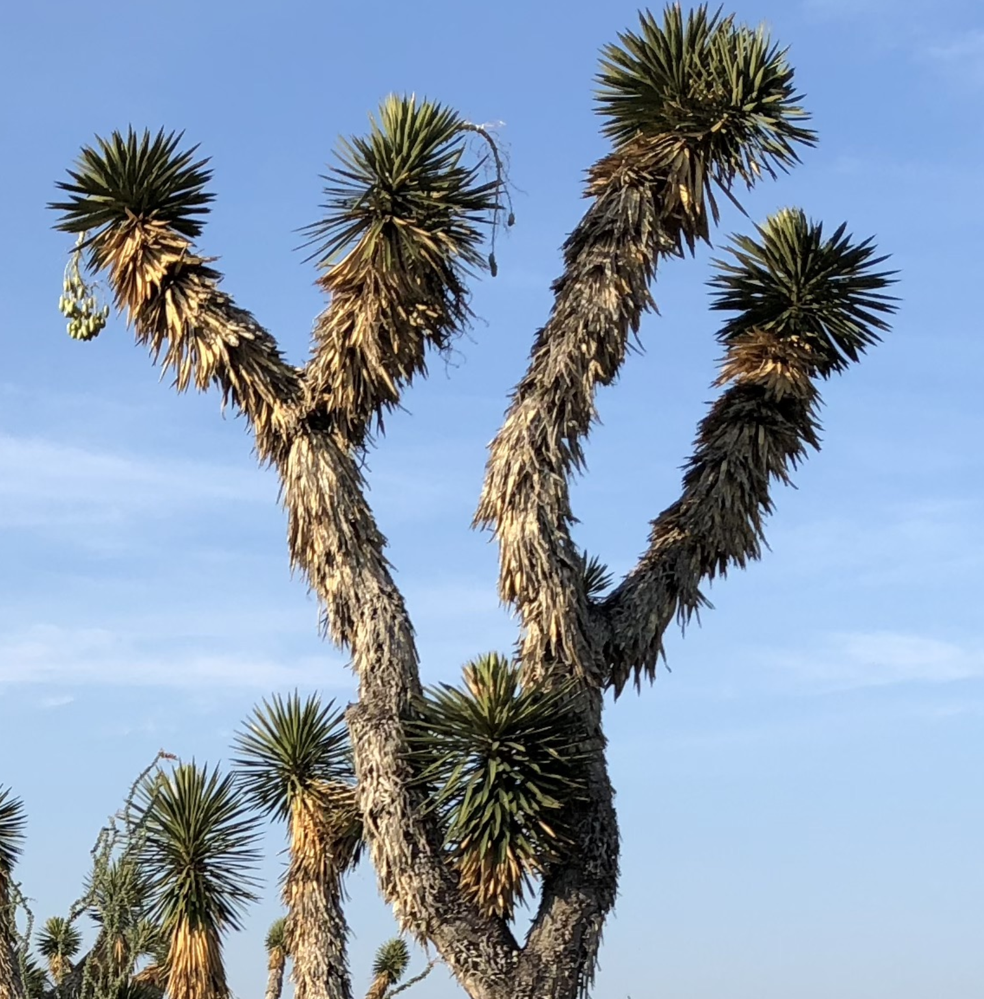| 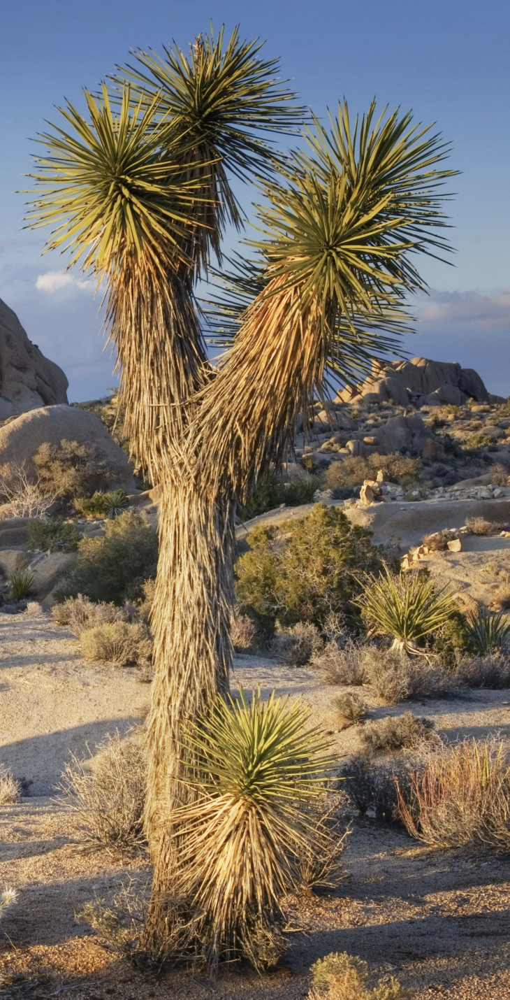
|13|14|15|16|17|18|
| 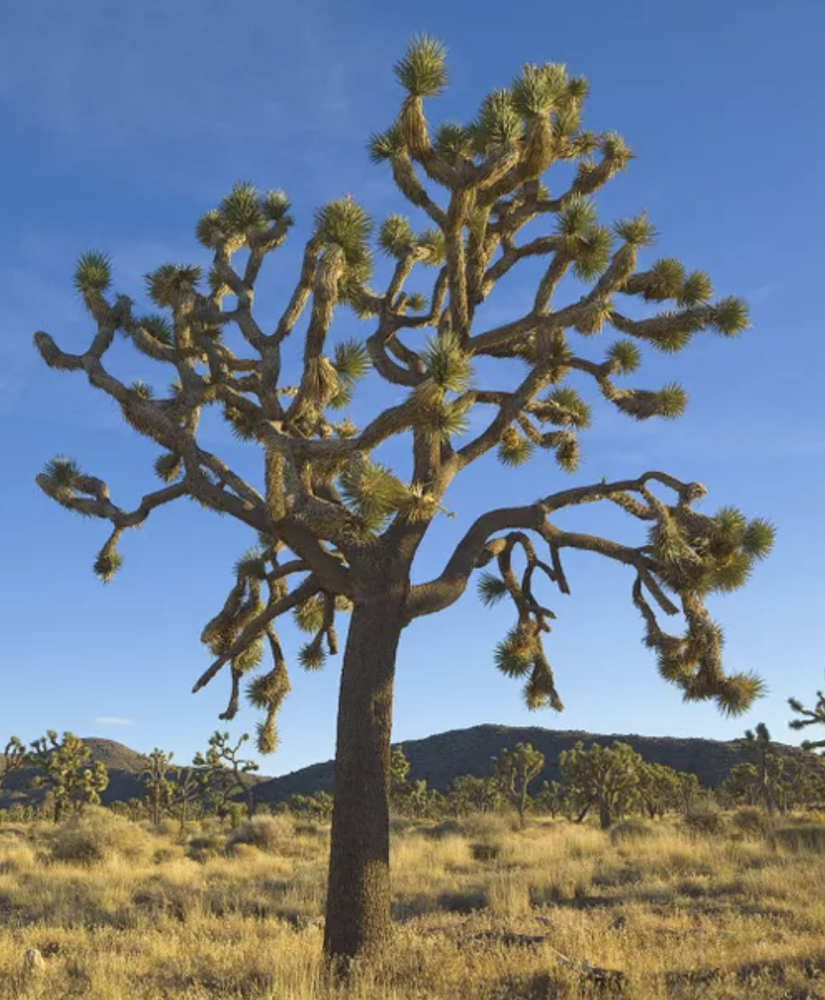 | 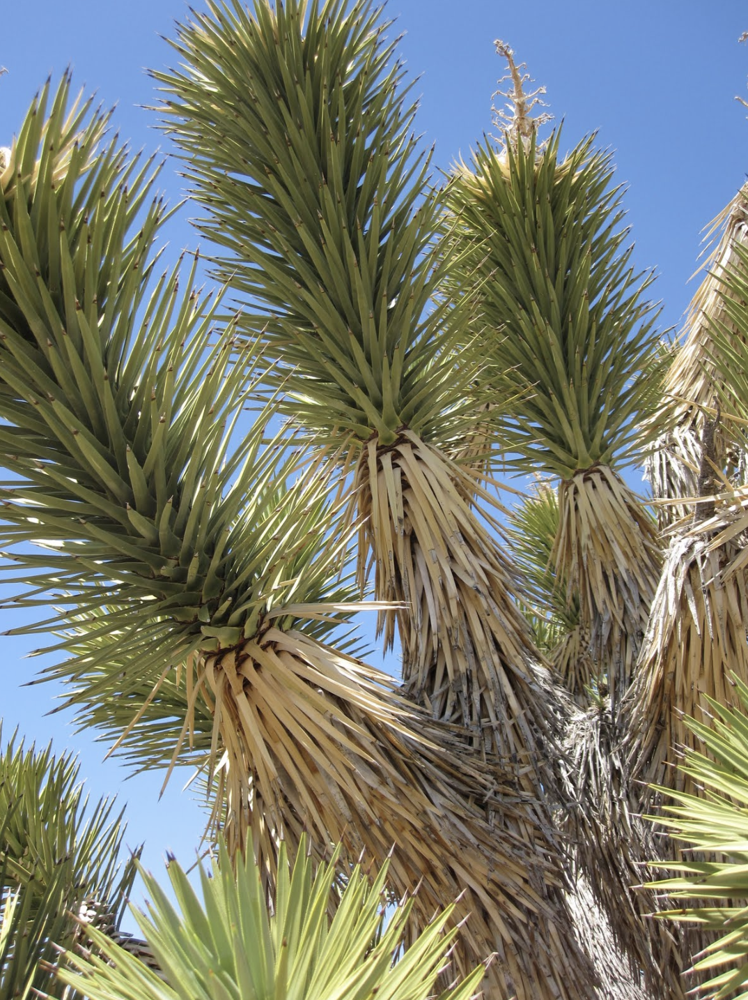 | 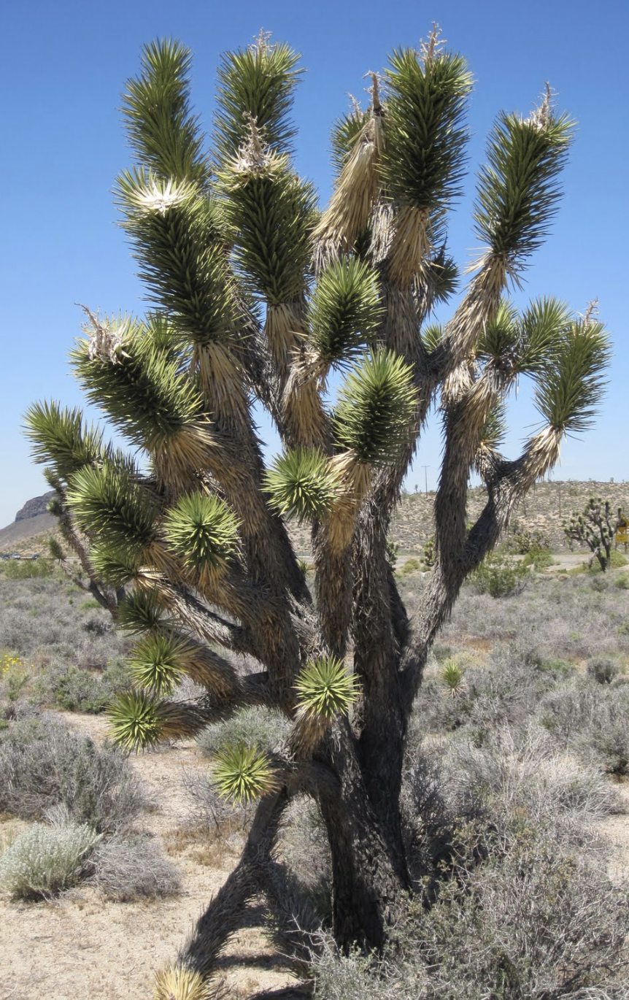 | 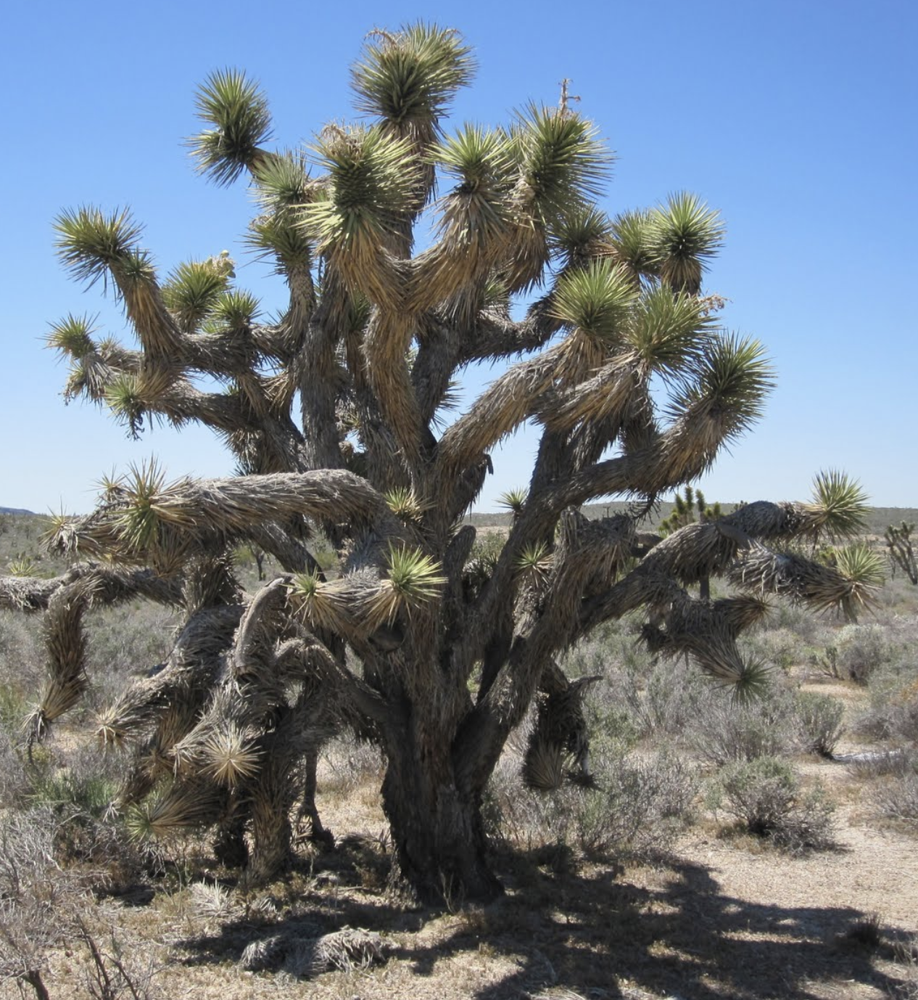 | 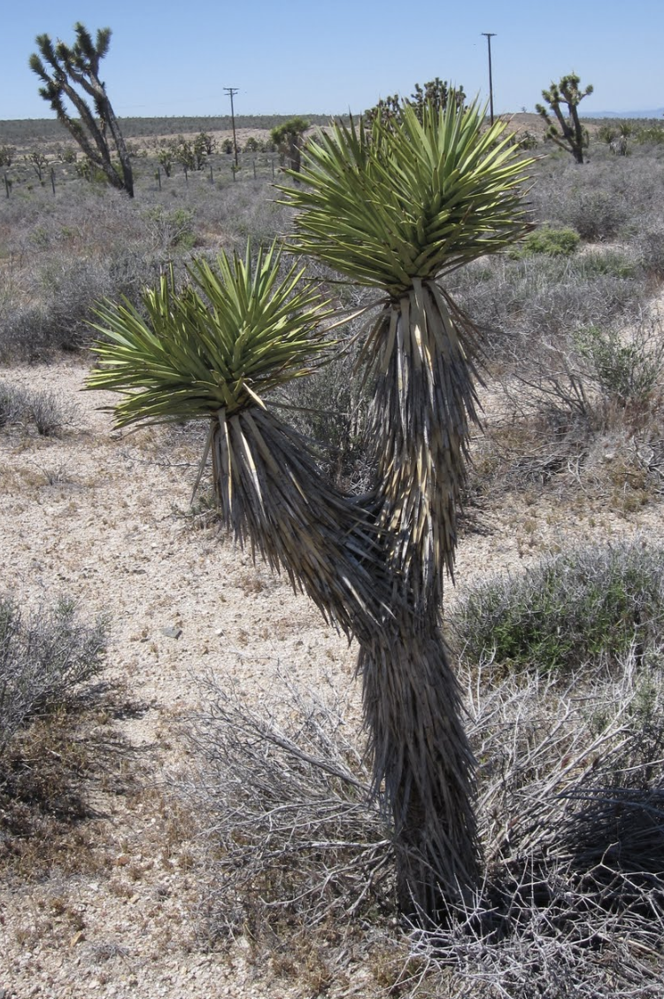

Observations:
* In general, the trunk size remains relativelty constant from the base all the way to the terminal branches (high `WIDTH_CHANGE`)
* Larger trees (#1,#2) can be fairly symmetrical (high `LENGTH_CHANGE`)
* Some trees can be slanted (#5,#7,#10)
* All but the largest trees have tall initial segments
* Tall, "simple" trees (#3,#6,#8) have low depth (~3?), long base trunks (large `INITIAL_LENGTH`), and rapidly shrink (large `LENGTH_CHANGE`)
* It's not uncommon to have huge angle variations on some branches (sometimes 90 degrees)
* There are often long single, yet curvy, branches (this indicates that `SPLIT_PROB` should decrease with depth, not currently implemented)

From [this description](http://www.flowersociety.org/JT_Botanical.htm):

> Unlike a typical tree branch, this new stem grows rigidly in a totally different direction, at an angle, horizontally, or even down towards the ground. Each branching stem also abruptly ends its growth after blossoming, and further branches veer off in new directions. As well as ending in blossoming, branching may occur where a stem has been damaged by insects.

> After many years, some Joshua trees develop a complex system of twisted branches growing in many directions. Others develop a more harmonious tree shape, while still others remain mostly vertical. The amazing variety of shapes and growth patterns imparts an unusual individuality to each tree.

First trial is to mimic tree #1 (low depth, thick trunks, long segments):

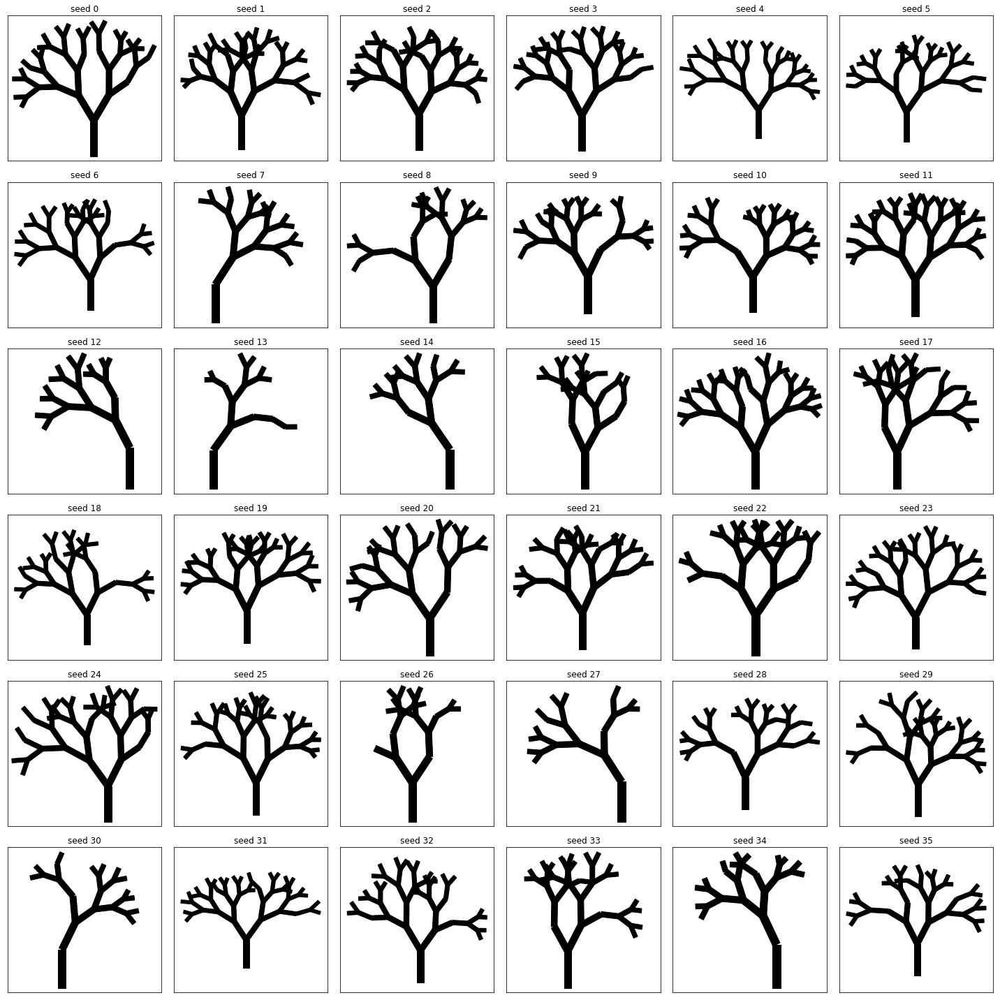

In [772]:
C = {'x0':0,
    'y0':0,
    'INITIAL_LENGTH':5,
    'LENGTH_CHANGE':0.8,
    'LENGTH_VARY_PROP':0.2,
    'INITIAL_ANGLE':-90,
    'ANGLE_CHANGE':30,
    'ANGLE_VARY_PROP':0.4,
    'SPLIT_PROB':0.9,
    'INITIAL_WIDTH':1,
    'WIDTH_CHANGE':0.9,
    'DEPTH':6}

def drawTree(x1, y1, angle, length, width, depth, C):
    if depth:
        # Calculatre end position of segment
        x2 = x1 + np.cos(np.radians(angle)) * length
        y2 = y1 - np.sin(np.radians(angle)) * length
        # Plot
        w = (depth**2)/8
        rect = Rectangle((x1-(width/2), y1), width, length, color='k')
        t = mpl.transforms.Affine2D().rotate_deg_around(x1,y1,-angle-90) + plt.gca().transData
        rect.set_transform(t)
        plt.gca().add_patch(rect)
        # Randomise the angle & length changes
        rnd1 = np.random.random(4) - 0.5
        l1 = C['LENGTH_CHANGE'] + (rnd1[0] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        l2 = C['LENGTH_CHANGE'] + (rnd1[1] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        a1 = C['ANGLE_CHANGE']  + (rnd1[2] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        a2 = C['ANGLE_CHANGE']  + (rnd1[3] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        # Draw two more branches
        rnd2 = np.random.random(2)
        if rnd2[0] < C['SPLIT_PROB']: drawTree(x2, y2, angle-a1, length*l1, width*C['WIDTH_CHANGE'], depth-1, C)
        if rnd2[1] < C['SPLIT_PROB']: drawTree(x2, y2, angle+a2, length*l2, width*C['WIDTH_CHANGE'], depth-1, C)
            
plt.figure(figsize=(20,20))
for i in range(36):
    seed = i
    np.random.seed(seed)
    plt.subplot(6,6,i+1)
    drawTree(C['x0'], C['y0'], C['INITIAL_ANGLE'], C['INITIAL_LENGTH'], C['INITIAL_WIDTH'], C['DEPTH'], C)
    plt.axis('equal')
    plt.title('seed {}'.format(seed))
    plt.tick_params(axis='both',which='both',bottom=False,left=False,labelbottom=False,labelleft=False)

plt.tight_layout()
plt.show()

And the second test should copy the simpler tall trees - which start of with a long base trunk, and have a just few low angle splits:

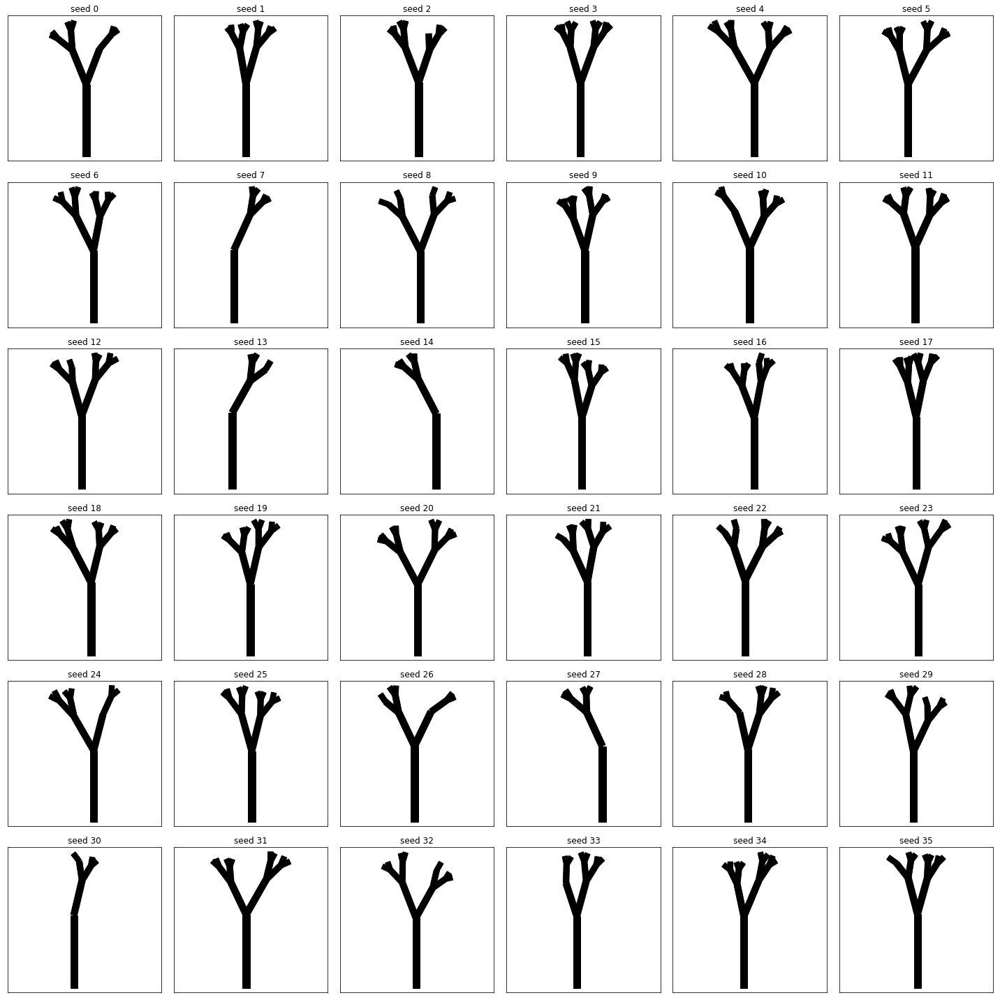

In [773]:
C = {'x0':0,
    'y0':0,
    'INITIAL_LENGTH':10,
    'LENGTH_CHANGE':0.5,
    'LENGTH_VARY_PROP':0.2,
    'INITIAL_ANGLE':-90,
    'ANGLE_CHANGE':20,
    'ANGLE_VARY_PROP':1.0,
    'SPLIT_PROB':0.95,
    'INITIAL_WIDTH':1,
    'WIDTH_CHANGE':0.9,
    'DEPTH':4}

def drawTree(x1, y1, angle, length, width, depth, C):
    if depth:
        # Calculatre end position of segment
        x2 = x1 + np.cos(np.radians(angle)) * length
        y2 = y1 - np.sin(np.radians(angle)) * length
        # Plot
        w = (depth**2)/8
        rect = Rectangle((x1-(width/2), y1), width, length, color='k')
        t = mpl.transforms.Affine2D().rotate_deg_around(x1,y1,-angle-90) + plt.gca().transData
        rect.set_transform(t)
        plt.gca().add_patch(rect)
        # Randomise the angle & length changes
        rnd1 = np.random.random(4) - 0.5
        l1 = C['LENGTH_CHANGE'] + (rnd1[0] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        l2 = C['LENGTH_CHANGE'] + (rnd1[1] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        a1 = C['ANGLE_CHANGE']  + (rnd1[2] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        a2 = C['ANGLE_CHANGE']  + (rnd1[3] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        # Draw two more branches
        rnd2 = np.random.random(2)
        if rnd2[0] < C['SPLIT_PROB']: drawTree(x2, y2, angle-a1, length*l1, width*C['WIDTH_CHANGE'], depth-1, C)
        if rnd2[1] < C['SPLIT_PROB']: drawTree(x2, y2, angle+a2, length*l2, width*C['WIDTH_CHANGE'], depth-1, C)
            
plt.figure(figsize=(20,20))
for i in range(36):
    seed = i
    np.random.seed(seed)
    plt.subplot(6,6,i+1)
    drawTree(C['x0'], C['y0'], C['INITIAL_ANGLE'], C['INITIAL_LENGTH'], C['INITIAL_WIDTH'], C['DEPTH'], C)
    plt.axis('equal')
    plt.title('seed {}'.format(seed))
    plt.tick_params(axis='both',which='both',bottom=False,left=False,labelbottom=False,labelleft=False)
plt.tight_layout()
plt.show()

These two simple parameter combinations allow a decent first pass at generating two drastically different stlyed trees. Amazingly, even just be keeping the trunks the same width it makes a huge different in terms of their similarity to actual trees.

Now we can think about adding some more functionality to the system. First, let's allow the split probability (`SPLIT_PROB`) to decrease by a factor of `SPLIT_PROB_CHANGE` with each iteration, which should have the effect of producing long, curvy branches:

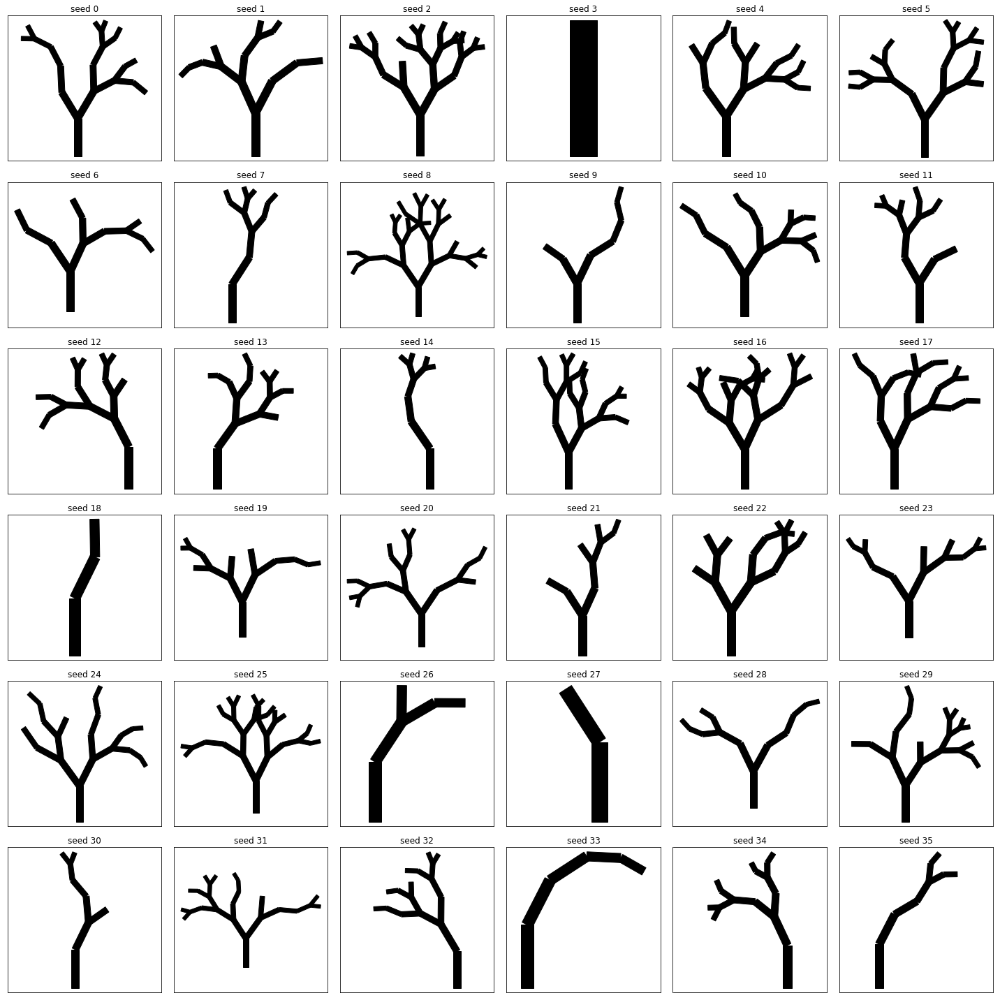

In [774]:
C1 = {'x0':0,
    'y0':0,
    'INITIAL_LENGTH':5,
    'LENGTH_CHANGE':0.8,
    'LENGTH_VARY_PROP':0.2,
    'INITIAL_ANGLE':-90,
    'ANGLE_CHANGE':30,
    'ANGLE_VARY_PROP':0.4,
    'SPLIT_PROB':0.9,
    'SPLIT_PROB_CHANGE': 0.9,
    'INITIAL_WIDTH':1,
    'WIDTH_CHANGE':0.9,
    'DEPTH':6}

def drawTree(x1, y1, angle, length, width, depth, C):
    if depth:
        # Calculatre end position of segment
        x2 = x1 + np.cos(np.radians(angle)) * length
        y2 = y1 - np.sin(np.radians(angle)) * length
        # Plot
        w = (depth**2)/8
        rect = Rectangle((x1-(width/2), y1), width, length, color='k')
        t = mpl.transforms.Affine2D().rotate_deg_around(x1,y1,-angle-90) + plt.gca().transData
        rect.set_transform(t)
        plt.gca().add_patch(rect)
        # Randomise the angle & length changes
        rnd1 = np.random.random(4) - 0.5
        l1 = C['LENGTH_CHANGE'] + (rnd1[0] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        l2 = C['LENGTH_CHANGE'] + (rnd1[1] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        a1 = C['ANGLE_CHANGE']  + (rnd1[2] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        a2 = C['ANGLE_CHANGE']  + (rnd1[3] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        # Reduce split probability
        C['SPLIT_PROB']  = C['SPLIT_PROB'] * C['SPLIT_PROB_CHANGE']
        # Draw two more branches
        rnd2 = np.random.random(2)
        if rnd2[0] < C['SPLIT_PROB']: drawTree(x2, y2, angle-a1, length*l1, width*C['WIDTH_CHANGE'], depth-1, copy.deepcopy(C))
        if rnd2[1] < C['SPLIT_PROB']: drawTree(x2, y2, angle+a2, length*l2, width*C['WIDTH_CHANGE'], depth-1, copy.deepcopy(C))
            
plt.figure(figsize=(20,20))
for i in range(36):
    seed = i
    np.random.seed(seed)
    plt.subplot(6,6,i+1)
    drawTree(C1['x0'], C1['y0'], C1['INITIAL_ANGLE'], C1['INITIAL_LENGTH'], C1['INITIAL_WIDTH'], C1['DEPTH'], copy.deepcopy(C1))
    plt.axis('equal')
    plt.title('seed {}'.format(seed))
    plt.tick_params(axis='both',which='both',bottom=False,left=False,labelbottom=False,labelleft=False)
    
plt.tight_layout()
plt.show()

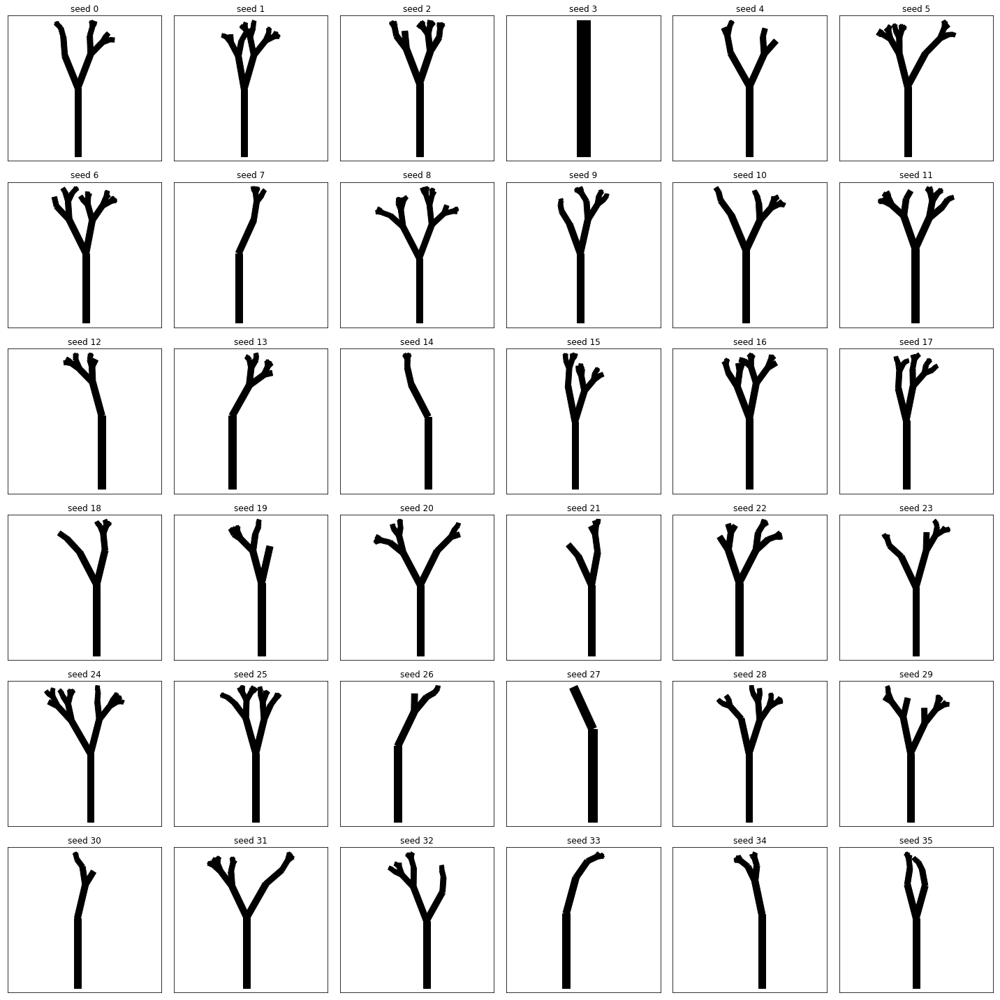

In [775]:
C2 = {'x0':0,
    'y0':0,
    'INITIAL_LENGTH':10,
    'LENGTH_CHANGE':0.5,
    'LENGTH_VARY_PROP':0.2,
    'INITIAL_ANGLE':-90,
    'ANGLE_CHANGE':20,
    'ANGLE_VARY_PROP':1.0,
    'SPLIT_PROB':0.95,
    'SPLIT_PROB_CHANGE': 0.9,
    'INITIAL_WIDTH':1,
    'WIDTH_CHANGE':0.9,
    'DEPTH':6}

plt.figure(figsize=(20,20))
for i in range(36):
    seed = i
    np.random.seed(seed)
    plt.subplot(6,6,i+1)
    drawTree(C2['x0'], C2['y0'], C2['INITIAL_ANGLE'], C2['INITIAL_LENGTH'], C2['INITIAL_WIDTH'], C2['DEPTH'], copy.deepcopy(C2))
    plt.axis('equal')
    plt.title('seed {}'.format(seed))
    plt.tick_params(axis='both',which='both',bottom=False,left=False,labelbottom=False,labelleft=False)
    
plt.tight_layout()
plt.show()

Great! So by varying `SPLIT_PROB_CHANGE` we can have the previous Type I trees (at a value of `1.0`) or increasingly weirder versions of these trees (at lower values of `0.9`). For these trees anything lower and the split probality decreases too rapidly resulting in the trees being too bare. Type II trees need to be compensated with larger `DEPTH` (in order to allow curvature to form), which adds a nice amount of weirdness.

The next thing to add is the extreme angle changes... a simple (but stupid) way of doing this is just to enforce a large angle change at some set probability:

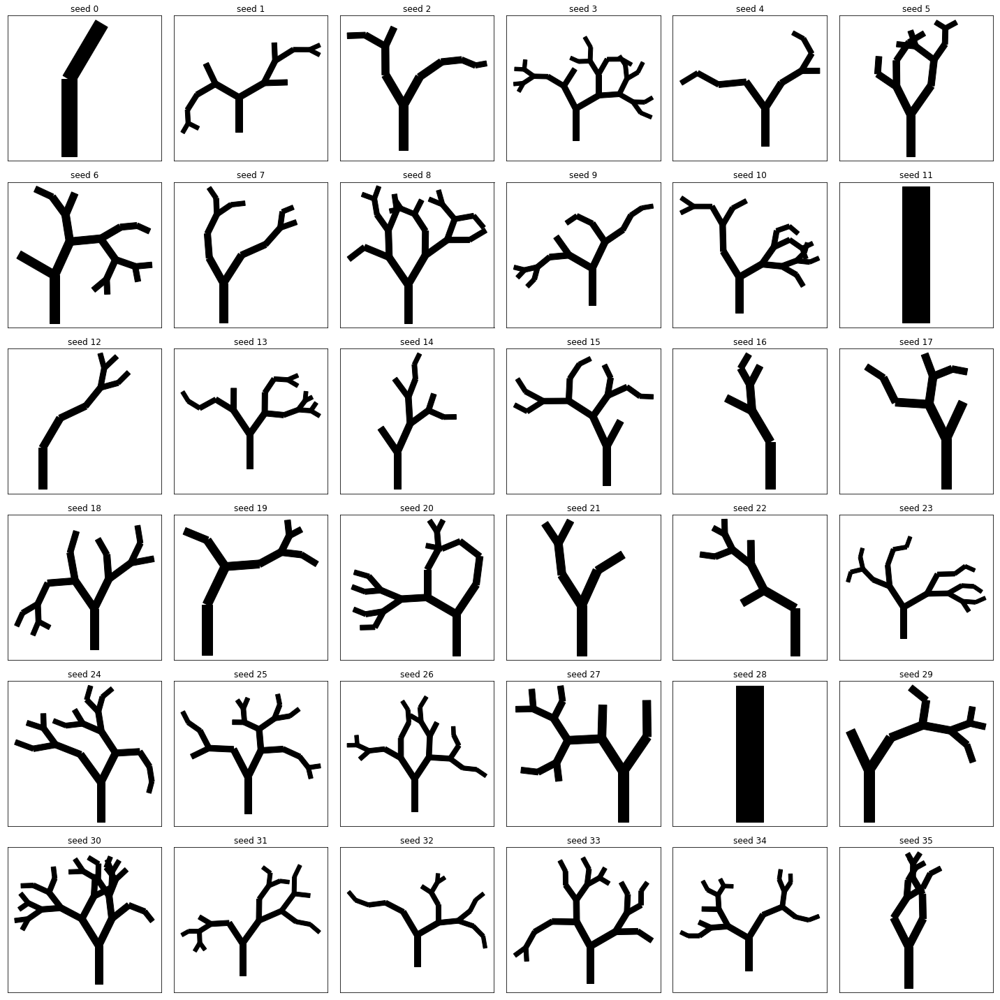

In [776]:
C1 = {'x0':0,
    'y0':0,
    'INITIAL_LENGTH':5,
    'LENGTH_CHANGE':0.8,
    'LENGTH_VARY_PROP':0.2,
    'INITIAL_ANGLE':-90,
    'ANGLE_CHANGE':30,
    'ANGLE_VARY_PROP':0.4,
    'SPLIT_PROB':0.9,
    'SPLIT_PROB_CHANGE': 0.9,
    'INITIAL_WIDTH':1,
    'WIDTH_CHANGE':0.9,
    'DEPTH':6}

def drawTree(x1, y1, angle, length, width, depth, C):
    if depth:
        # Calculatre end position of segment
        x2 = x1 + np.cos(np.radians(angle)) * length
        y2 = y1 - np.sin(np.radians(angle)) * length
        # Plot
        w = (depth**2)/8
        rect = Rectangle((x1-(width/2), y1), width, length, color='k')
        t = mpl.transforms.Affine2D().rotate_deg_around(x1,y1,-angle-90) + plt.gca().transData
        rect.set_transform(t)
        plt.gca().add_patch(rect)
        # Randomise the angle & length changes
        rnd1 = np.random.random(4) - 0.5
        l1 = C['LENGTH_CHANGE'] + (rnd1[0] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        l2 = C['LENGTH_CHANGE'] + (rnd1[1] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        a1 = C['ANGLE_CHANGE']  + (rnd1[2] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        a2 = C['ANGLE_CHANGE']  + (rnd1[3] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        # Reduce split probability
        C['SPLIT_PROB']  = C['SPLIT_PROB'] * C['SPLIT_PROB_CHANGE']
        # Test right angle split
        r = np.random.random(4)
        if r[0] < 0.2: a1 = 60 * r[1]/np.abs(r[1]) 
        if r[2] < 0.2: a2 = 60 * r[3]/np.abs(r[3]) 
        # Draw two more branches
        rnd2 = np.random.random(2)
        if rnd2[0] < C['SPLIT_PROB']: drawTree(x2, y2, angle-a1, length*l1, width*C['WIDTH_CHANGE'], depth-1, copy.deepcopy(C))
        if rnd2[1] < C['SPLIT_PROB']: drawTree(x2, y2, angle+a2, length*l2, width*C['WIDTH_CHANGE'], depth-1, copy.deepcopy(C))
            
plt.figure(figsize=(20,20))
for i in range(36):
    seed = i
    np.random.seed(seed)
    plt.subplot(6,6,i+1)
    drawTree(C1['x0'], C1['y0'], C1['INITIAL_ANGLE'], C1['INITIAL_LENGTH'], C1['INITIAL_WIDTH'], C1['DEPTH'], copy.deepcopy(C1))
    plt.axis('equal')
    plt.title('seed {}'.format(seed))
    plt.tick_params(axis='both',which='both',bottom=False,left=False,labelbottom=False,labelleft=False)
    
plt.tight_layout()
plt.show()

This does get some of the way there, though does look a bit stupid. Another way would be to keep some memory of the previous branch, to allow a large fluctuating angle:

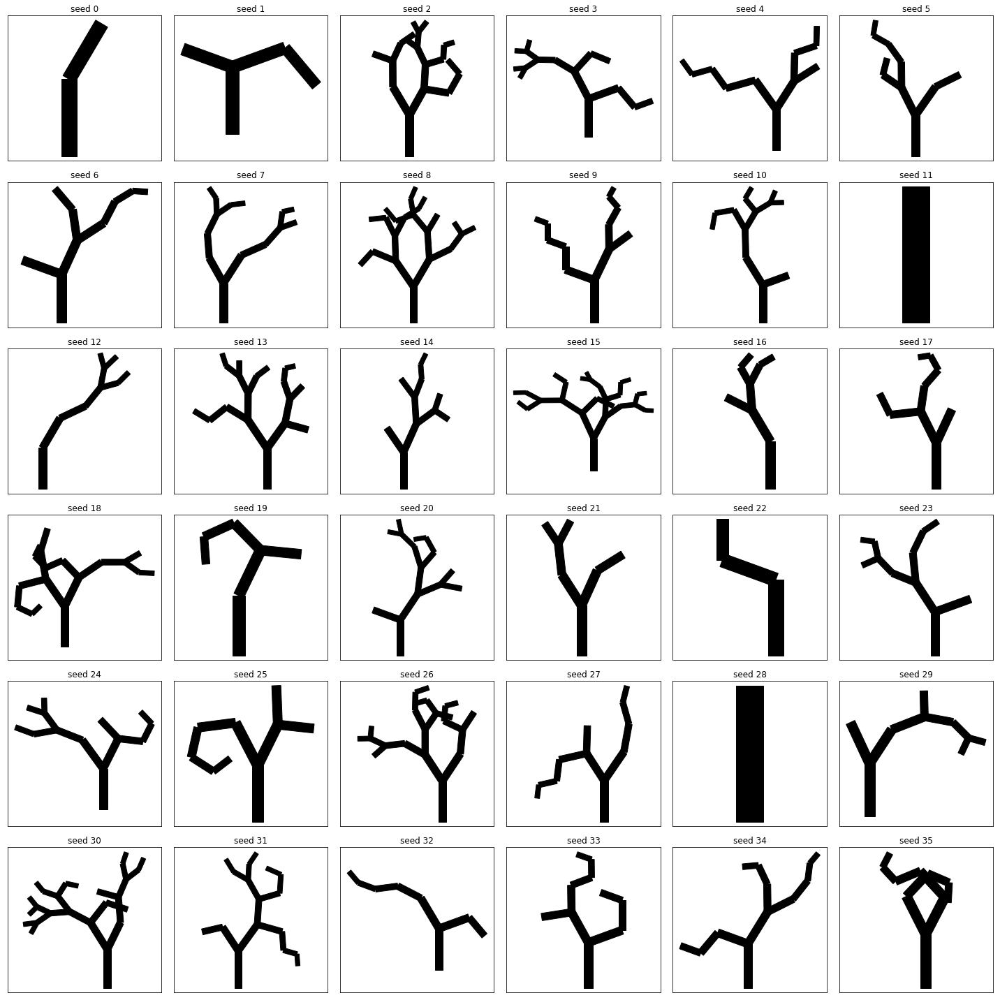

In [777]:
C1 = {'x0':0,
    'y0':0,
    'INITIAL_LENGTH':5,
    'LENGTH_CHANGE':0.8,
    'LENGTH_VARY_PROP':0.2,
    'INITIAL_ANGLE':-90,
    'ANGLE_CHANGE':30,
    'ANGLE_VARY_PROP':0.4,
    'SPLIT_PROB':0.9,
    'SPLIT_PROB_CHANGE': 0.9,
    'INITIAL_WIDTH':1,
    'WIDTH_CHANGE':0.9,
    'DEPTH':6}

def drawTree(x1, y1, angle, fluctuating, length, width, depth, C):
    if depth:
        # Calculatre end position of segment
        x2 = x1 + np.cos(np.radians(angle)) * length
        y2 = y1 - np.sin(np.radians(angle)) * length
        # Plot
        w = (depth**2)/8
        rect = Rectangle((x1-(width/2), y1), width, length, color='k')
        t = mpl.transforms.Affine2D().rotate_deg_around(x1,y1,-angle-90) + plt.gca().transData
        rect.set_transform(t)
        plt.gca().add_patch(rect)
        # Randomise the angle & length changes
        rnd1 = np.random.random(4) - 0.5
        l1 = C['LENGTH_CHANGE'] + (rnd1[0] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        l2 = C['LENGTH_CHANGE'] + (rnd1[1] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        a1 = C['ANGLE_CHANGE']  + (rnd1[2] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        a2 = C['ANGLE_CHANGE']  + (rnd1[3] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        # Reduce split probability
        C['SPLIT_PROB']  = C['SPLIT_PROB'] * C['SPLIT_PROB_CHANGE']
        # Test right angle split
        r = np.random.random(4)
        stop_split1 = 0
        stop_split2 = 0
        if r[0] < 0.2 and fluctuating==0:
            f1 = r[1]/abs(r[1])
            a1 = 70 * f1
        elif fluctuating != 0:
            f1 = -fluctuating
            a1 = 70 * f1
        else:
            f1 = fluctuating
            
        if r[2] < 0.2 and fluctuating==0:
            f2 = r[3]/abs(r[3])
            a2 = 70 * f2
        elif fluctuating != 0:
            f2 = -fluctuating
            a2 = 70 * f2
        else:
            f2 = fluctuating
        
        if fluctuating != 0:
            if np.random.random() < 0.5:
                stop_split1 = 1
            else:
                stop_split2 = 1
                
        # Draw two more branches
        rnd2 = np.random.random(2)
        if rnd2[0]+stop_split1 < C['SPLIT_PROB']: drawTree(x2, y2, angle-a1, f1, length*l1, width*C['WIDTH_CHANGE'], depth-1, copy.deepcopy(C))
        if rnd2[1]+stop_split2 < C['SPLIT_PROB']: drawTree(x2, y2, angle+a2, f2, length*l2, width*C['WIDTH_CHANGE'], depth-1, copy.deepcopy(C))
            
plt.figure(figsize=(20,20))
for i in range(36):
    seed = i
    np.random.seed(seed)
    plt.subplot(6,6,i+1)
    drawTree(C1['x0'], C1['y0'], C1['INITIAL_ANGLE'], 0, C1['INITIAL_LENGTH'], C1['INITIAL_WIDTH'], C1['DEPTH'], copy.deepcopy(C1))
    plt.axis('equal')
    plt.title('seed {}'.format(seed))
    plt.tick_params(axis='both',which='both',bottom=False,left=False,labelbottom=False,labelleft=False)
    
plt.tight_layout()
plt.show()

## 3 - Textures

Our simple black silhouette-like branch segments are not yet resembling Joshua Trees because they are lacking two distinct characteristics: the leaves and the shaggy bark which covers parts of the trunk. Actually, upon reading it appears the spiky bark are actually older leaves which change from upright green spikes, to downward facing brown-grey spikes which protect the trunk:

> The younger ones remain green, but as they age the leaves fade to gray and become a fibrous residue which droops and finally covers the branch or trunk in a protective coating.

So to make them look better, we will simulate these two effects.

### Trunk spikes

The trunk spikes can be simulated by a host of downard-facing near-isoscelese triangles. By observing the samples above, we can see a few important parameters we might wish to include: firstly, the density of the spikes decreases as you move up toward the tree (and often, they only begin appearing after the first split); 2) as you get closer and closer to the green leaves, they start to point radially out (rather than directly 'down' along the axis of the trunk). So both the density and radial pointing are proportional to how close to the terminal branch they are.

Before worrying about _how_ to vary the density, let's just play with the parameters and drawing routines, for a static rectangle, and assume the density will later be a function of the depth (relative to where the branch terminates).

In [3]:
# Now add a function to vary a given colour slightly, so we can make each spike a slightly different shade
def mod_col(col, amount, n):
    assert amount >= 0 and amount <= 1, "Colour adjustment amount must be between 0 and 1"
    r = (np.random.random((n,3))-0.5)*amount
    new_cols = np.tile(col,(n,1)) + r
    new_cols[new_cols > 1] = 1
    new_cols[new_cols < 0] = 0
    return new_cols

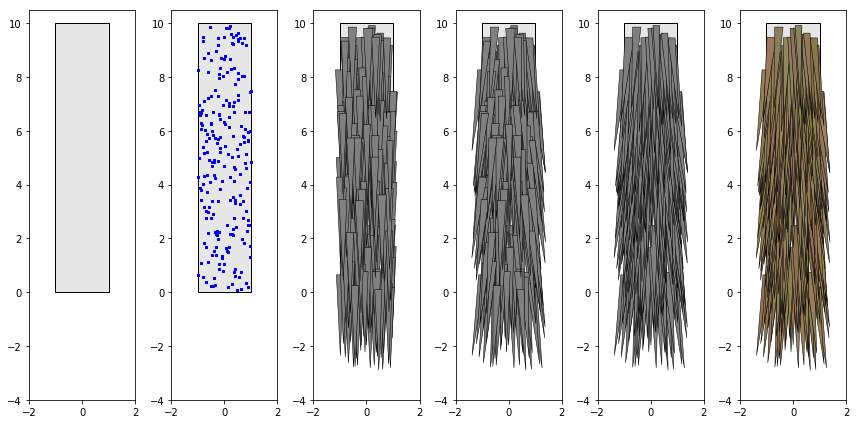

In [4]:
# Simulate how the coordinates are defined for the trees
x1, y1 = 0, 0
width, length = 2, 10
rx, ry = x1-(width/2), y1
rect1 = Rectangle((rx,ry), width, length, facecolor='0.9', edgecolor='k', zorder=0)
rect2 = Rectangle((rx,ry), width, length, facecolor='0.9', edgecolor='k', zorder=0)
rect3 = Rectangle((rx,ry), width, length, facecolor='0.9', edgecolor='k', zorder=0)
rect4 = Rectangle((rx,ry), width, length, facecolor='0.9', edgecolor='k', zorder=0)
rect5 = Rectangle((rx,ry), width, length, facecolor='0.9', edgecolor='k', zorder=0)
rect6 = Rectangle((rx,ry), width, length, facecolor='0.9', edgecolor='k', zorder=0)

# Parameters
SPIKE_WIDTH = 0.15 # how wide is a spike, relative to the branch width?
SPIKE_LENGTH = 1.5 # how long is a spike, relative to the branch width?
SPIKE_JITTER = 0.5 # what % do we allow the width/height to vary?
SPIKE_DENSITY = 5 # what proportion of the branch area do we want covered (approx)?
SPIKE_SPREAD = 0.2 # what proportion of the width can the spikes spread out?

# Determine how many spikes we need (approx) = area of branch / area of average spike
n = int((width*length) / (0.5*SPIKE_WIDTH*width*SPIKE_LENGTH*width)) * SPIKE_DENSITY
# Produce the positions (top middle of spike)
pos = np.random.random((n,2)) * np.array([width, length]) + np.array([rx,ry])

# Calculate the jitter proportion the top of the spike
jitter_x1 = 1+((np.random.random(n)-0.5)*SPIKE_JITTER)
jitter_x2 = 1+((np.random.random(n)-0.5)*SPIKE_JITTER)

# Calculate the verticies of the triangles
v1 = pos - np.array([(jitter_x1*SPIKE_WIDTH*width/2),np.zeros(n)]).T
v2 = pos + np.array([(jitter_x2*SPIKE_WIDTH*width/2),np.zeros(n)]).T
v3 = pos - np.array([0,SPIKE_LENGTH*width])

# Produce the basic patches
spikes_list = []
for i in range(n):
    spikes_list.append(plt.Polygon([v1[i,:],v2[i,:],v3[i,:]]))
spikes_collection = PatchCollection(spikes_list, zorder=10, color='0.5', edgecolor='k', lw=0.5)

# Adjust & the radially pointing patches
edge_distance = (pos[:,0]-x1) / (width/2) #what proportion are they to the edge (with +/- sign)
spread = edge_distance * SPIKE_SPREAD * width
v3[:,0] += spread
radial_spikes_list = []
for i in range(n):
    radial_spikes_list.append(plt.Polygon([v1[i,:],v2[i,:],v3[i,:]]))
radial_spikes_collection = PatchCollection(radial_spikes_list, zorder=10, color='0.5', edgecolor='k', lw=0.5)

# Sort them so they draw in the correct order
sort_idx = np.argsort(v1[:,1])
sorted_spikes_list = []
for i in range(n):
    sorted_spikes_list.append(plt.Polygon([v1[i,:],v2[i,:],v3[i,:]]))
sorted_spikes_list = list(np.array(sorted_spikes_list)[sort_idx])
sorted_spikes_collection = PatchCollection(sorted_spikes_list, zorder=10, color='0.5', edgecolor='k', lw=0.5)

# Make some shades of brown
col = [0.41, 0.53, 0.68]
col = [147/255, 124/255, 87/255]
cols = mod_col(col, 0.1, n)
coloured_spikes_list = []
for i in range(n):
    coloured_spikes_list.append(plt.Polygon([v1[i,:],v2[i,:],v3[i,:]]))
coloured_spikes_list = list(np.array(coloured_spikes_list)[sort_idx])
coloured_spikes_collection = PatchCollection(coloured_spikes_list, zorder=10, facecolors=cols, edgecolor='k', lw=0.5)

# Draw it, showing the progression of the features added
plt.figure(figsize=(12,6))

# The basic trunk segment
plt.subplot(1,6,1)
plt.gca().add_patch(rect1)
plt.xlim(-2,2)
plt.ylim(-4,10.5)

# + positions of the tops of the spikes
plt.subplot(1,6,2)
plt.gca().add_patch(rect2)
plt.scatter(pos[:,0], pos[:,1], c='b', s=5, marker='s')
plt.xlim(-2,2)
plt.ylim(-4,10.5)

# + the triangles
plt.subplot(1,6,3)
plt.gca().add_patch(rect3)
plt.gca().add_collection(spikes_collection)
plt.xlim(-2,2)
plt.ylim(-4,10.5)

# + radially spread
plt.subplot(1,6,4)
plt.gca().add_patch(rect4)
plt.gca().add_collection(radial_spikes_collection)
plt.xlim(-2,2)
plt.ylim(-4,10.5)

# + sorted vertically
plt.subplot(1,6,5)
plt.gca().add_patch(rect5)
plt.gca().add_collection(sorted_spikes_collection)
plt.xlim(-2,2)
plt.ylim(-4,10.5)

# + random colours
plt.subplot(1,6,6)
plt.gca().add_patch(rect6)
plt.gca().add_collection(coloured_spikes_collection)
plt.xlim(-2,2)
plt.ylim(-4,10.5)

plt.tight_layout()
plt.show()

### Leaf spikes

The leaf spikes are very similar to the trunk spikes, with the main exception that they typically radiate out in all directions fairly evenly.

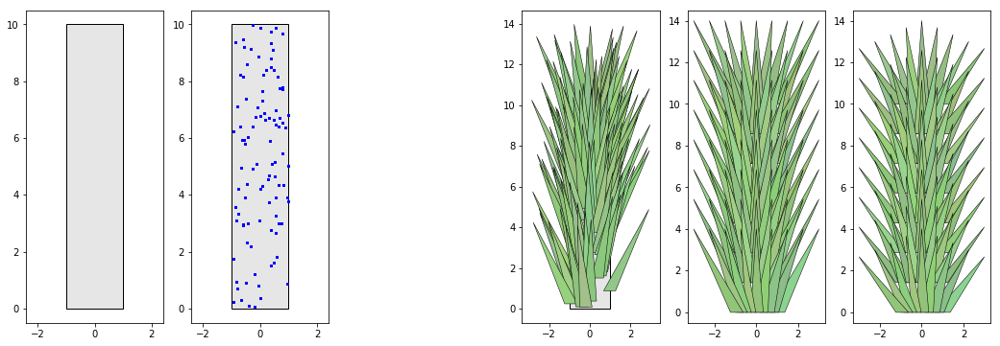

In [5]:
# Simulate how the coordinates are defined for the trees
x1, y1 = 0, 0
width, length = 2, 10
rx, ry = x1-(width/2), y1
rect1 = Rectangle((rx,ry), width, length, facecolor='0.9', edgecolor='k', zorder=0)
rect2 = Rectangle((rx,ry), width, length, facecolor='0.9', edgecolor='k', zorder=0)
rect3 = Rectangle((rx,ry), width, length, facecolor='0.9', edgecolor='k', zorder=0)

# Parameters
SPIKE_WIDTH = 0.3 # how wide is a spike, relative to the branch width?
SPIKE_LENGTH = 2 # how long is a spike, relative to the branch width?
SPIKE_JITTER = 0.1 # what % do we allow the width/height to vary?
SPIKE_DENSITY = 6 # what proportion of the branch area do we want covered (approx)?
SPIKE_SPREAD = 1 # what proportion of the width can the spikes spread out?

# Determine how many spikes we need (approx) = area of branch / area of average spike
n = int((width*length) / (0.5*SPIKE_WIDTH*width*SPIKE_LENGTH*width) * SPIKE_DENSITY)
# Produce the positions (top middle of spike)
pos = np.random.random((n,2)) * np.array([width, length]) + np.array([rx,ry])
pos0 = np.copy(pos)

# Calculate the jitter proportion the top of the spike
jitter_x1 = 1+((np.random.random(n)-0.5)*SPIKE_JITTER)
jitter_x2 = 1+((np.random.random(n)-0.5)*SPIKE_JITTER)

# Calculate the verticies of the triangles
v1 = pos - np.array([(jitter_x1*SPIKE_WIDTH*width/2),np.zeros(n)]).T
v2 = pos + np.array([(jitter_x2*SPIKE_WIDTH*width/2),np.zeros(n)]).T
v3 = pos + np.array([0,SPIKE_LENGTH*width])

# Adjust & the radially pointing patches
edge_distance = (pos[:,0]-x1) / (width/2) #what proportion are they to the edge (with +/- sign)
spread = edge_distance * SPIKE_SPREAD * width
v3[:,0] += spread

# Make some shades of green
col = [150/255, 200/255, 130/255]
cols = mod_col(col, 0.1, n)
coloured_spikes_list = []
for i in range(n):
    coloured_spikes_list.append(plt.Polygon([v1[i,:],v2[i,:],v3[i,:]]))
sort_idx = np.argsort(v1[:,1])[::-1]
coloured_spikes_list = list(np.array(coloured_spikes_list)[sort_idx])
coloured_spikes_collection = PatchCollection(coloured_spikes_list, zorder=10, facecolors=cols, edgecolor='k', lw=0.5)


# Repeat but with an ordered grid rather than random
nx,ny=9,8
n=nx*ny
posx, posy = np.meshgrid(np.linspace(rx,rx+width,nx), np.linspace(ry,ry+length,ny))
pos = np.vstack([posx.reshape(-1), posy.reshape(-1)]).T

# Calculate the jitter proportion the top of the spike
SPIKE_JITTER = 0.5
jitter_x1 = 1+((np.random.random(n)-0.5)*SPIKE_JITTER)
jitter_x2 = 1+((np.random.random(n)-0.5)*SPIKE_JITTER)

# Calculate the verticies of the triangles
v1 = pos - np.array([(jitter_x1*SPIKE_WIDTH*width/2),np.zeros(n)]).T
v2 = pos + np.array([(jitter_x2*SPIKE_WIDTH*width/2),np.zeros(n)]).T
v3 = pos + np.array([0,SPIKE_LENGTH*width])

# Adjust & the radially pointing patches
edge_distance = (pos[:,0]-x1) / (width/2) #what proportion are they to the edge (with +/- sign)
spread = edge_distance * SPIKE_SPREAD * width
v3[:,0] += spread

reg_coloured_spikes_list = []
for i in range(n):
    reg_coloured_spikes_list.append(plt.Polygon([v1[i,:],v2[i,:],v3[i,:]]))
sort_idx = np.argsort(v1[:,1])[::-1]
reg_coloured_spikes_list = list(np.array(reg_coloured_spikes_list)[sort_idx])
reg_coloured_spikes_collection = PatchCollection(reg_coloured_spikes_list, zorder=10, facecolors=cols, edgecolor='k', lw=0.5)

# Try again, but adjust the heights by the spread too
# Really the length of a leaf should be fixed, and the radial spread should be defined by an angle
# This way, the effective length of the leaves wouldn't increase as they spread out
# But adjusting the length down is a quick way to approximate this and at least see how it looks
v3[:,1] -= np.abs(spread)/1.5

reg_coloured_spikes_list2 = []
for i in range(n):
    reg_coloured_spikes_list2.append(plt.Polygon([v1[i,:],v2[i,:],v3[i,:]]))
reg_coloured_spikes_list2 = list(np.array(reg_coloured_spikes_list2)[sort_idx])
reg_coloured_spikes_collection2 = PatchCollection(reg_coloured_spikes_list2, zorder=10, facecolors=cols, edgecolor='k', lw=0.5)


# Draw
plt.figure(figsize=(18,6))

plt.subplot(1,6,1)
plt.gca().add_patch(rect1)
plt.xlim(-4,4)
plt.ylim(-1,14)
plt.axis('equal')

plt.subplot(1,6,2)
plt.gca().add_patch(rect2)
plt.scatter(pos0[:,0], pos0[:,1], c='b', s=5, marker='s')
plt.xlim(-4,4)
plt.ylim(-1,14)
plt.axis('equal')

plt.subplot(1,6,4)
plt.gca().add_patch(rect3)
plt.gca().add_collection(coloured_spikes_collection)
plt.xlim(-4,4)
plt.ylim(-1,14)
plt.axis('equal')

plt.subplot(1,6,5)
#plt.gca().add_patch(rect2)
plt.gca().add_collection(reg_coloured_spikes_collection)
plt.xlim(-4,4)
plt.ylim(-1,14)
plt.axis('equal')

plt.subplot(1,6,6)
#plt.gca().add_patch(rect3)
plt.gca().add_collection(reg_coloured_spikes_collection2)
plt.xlim(-4,4)
plt.ylim(-1,14)
plt.axis('equal')

plt.show()

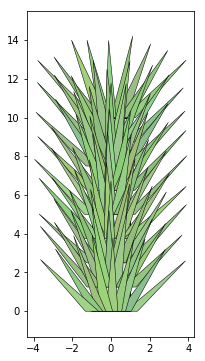

In [10]:
# Simulate how the coordinates are defined for the trees
x1, y1 = 0, 0
width, length = 2, 10
rx, ry = x1-(width/2), y1
rect1 = Rectangle((rx,ry), width, length, facecolor='0.9', edgecolor='k', zorder=0)

# Parameters
SPIKE_WIDTH = 0.3 # how wide is a spike, relative to the branch width?
SPIKE_LENGTH = 2 # how long is a spike, relative to the branch width?
SPIKE_JITTER = 0.1 # what % do we allow the width/height to vary?
SPIKE_DENSITY = 6 # what proportion of the branch area do we want covered (approx)?
SPIKE_SPREAD = 1 # what proportion of the width can the spikes spread out?

# Repeat but with an ordered grid rather than random
nx,ny=9,9
n=nx*ny
posx, posy = np.meshgrid(np.linspace(rx,rx+width,nx), np.linspace(ry,ry+length,ny))
pos = np.vstack([posx.reshape(-1), posy.reshape(-1)]).T

# Calculate the jitter proportion the top of the spike
SPIKE_JITTER = 0.5
jitter_x1 = 1+((np.random.random(n)-0.5)*SPIKE_JITTER)
jitter_x2 = 1+((np.random.random(n)-0.5)*SPIKE_JITTER)

# Calculate the verticies of the triangles
v1 = pos - np.array([(jitter_x1*SPIKE_WIDTH*width/2),np.zeros(n)]).T
v2 = pos + np.array([(jitter_x2*SPIKE_WIDTH*width/2),np.zeros(n)]).T
v3 = pos

# Adjust & the radially pointing patches
MAX_ANGLE = 45
edge_distance = (((v1[:,0]+v2[:,0])/2)-x1) / (width/2) #what proportion are they to the edge (with +/- sign)
angles = MAX_ANGLE*edge_distance
v3[:,0] += SPIKE_LENGTH*width * np.cos(np.radians(90-angles))
v3[:,1] += SPIKE_LENGTH*width * np.sin(np.radians(90-angles))

jitter_x3 = ((np.random.random(n)-0.5)*SPIKE_JITTER)*SPIKE_WIDTH*width
jitter_y3 = ((np.random.random(n)-0.5)*SPIKE_JITTER)*SPIKE_WIDTH*width*2
v3[:,0] += jitter_x3
v3[:,1] += jitter_y3

col = [150/255, 200/255, 130/255]
cols = mod_col(col, 0.1, n)
reg_coloured_spikes_list2 = []
for i in range(n):
    reg_coloured_spikes_list2.append(plt.Polygon([v1[i,:],v2[i,:],v3[i,:]]))
sort_idx = np.argsort(v1[:,1])[::-1]
reg_coloured_spikes_list2 = list(np.array(reg_coloured_spikes_list2)[sort_idx])
reg_coloured_spikes_collection2 = PatchCollection(reg_coloured_spikes_list2, zorder=10, facecolors=cols, edgecolor='k', lw=0.5)

# Draw
plt.figure(figsize=(3,6))
plt.gca().add_patch(rect1)
plt.gca().add_collection(reg_coloured_spikes_collection2)
#plt.plot(v1[:,0], v1[:,1], 'k.', zorder=100)
plt.axis('equal')
plt.show()

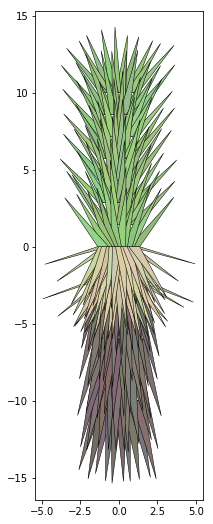

In [6]:
COL_GREEN  = [0.59, 0.78, 0.51]
COL_GREEN_YELLOW = [0.74, 0.80, 0.60]
COL_YELLOW = [0.84, 0.80, 0.66]
COL_BROWN = [0.49,0.45,0.44]

def draw_spikes(x1, y1, width, length,
                spike_direction=1, # 1=forwards; -1=backwards
                spike_colour=COL_GREEN,
                spike_colour_jitter=0.1,
                spike_width=0.3,
                spike_length=2,
                spike_jitter=0.5,
                spike_layout='regular',
                spike_density_x=3,
                spike_density_y=3,
                spike_density_rnd=10,
                spike_max_angle=40,
                spike_zorder=1):
    
    # Rect mid positions
    rx, ry = x1-(width/2), y1
    
    # Determine the initial base mid-points of all the spikes
    # Random
    if spike_layout == 'random':
        n = int((width*length) / (0.5*spike_width*width*spike_length*width) * spike_density_rnd)
        pos = np.random.random((n,2)) * np.array([width, length]) + np.array([rx,ry])
    # Regular
    elif spike_layout == 'regular':
        nx = int(np.ceil((1 / spike_width) * spike_density_x))
        ny = int(np.ceil((1 / (spike_length*width/length)) * spike_density_y))
        n = nx*ny
        posx, posy = np.meshgrid(np.linspace(rx,rx+width,nx), np.linspace(ry,ry+length,ny))
        pos = np.vstack([posx.reshape(-1), posy.reshape(-1)]).T
        
    # Jitter them for some randomness
    jitter_x1 = 1+((np.random.random(n)-0.5)*spike_jitter)
    jitter_x2 = 1+((np.random.random(n)-0.5)*spike_jitter)

    # Calculate the verticies of the triangles
    v1 = pos - np.array([(jitter_x1*spike_width*width/2),np.zeros(n)]).T
    v2 = pos + np.array([(jitter_x2*spike_width*width/2),np.zeros(n)]).T
    v3 = pos
    
    # Tip of spikes
    edge_distance = (((v1[:,0]+v2[:,0])/2)-x1) / (width/2) # what proportion are they to the edge (with +/- sign)
    angles = spike_direction*spike_max_angle*edge_distance
    v3[:,0] += spike_direction * spike_length*width * np.cos(np.radians(90-angles))
    v3[:,1] += spike_direction * spike_length*width * np.sin(np.radians(90-angles))
    
    # Jitter the tip
    jitter_x3 = ((np.random.random(n)-0.5)*spike_jitter)*spike_width*width
    jitter_y3 = ((np.random.random(n)-0.5)*spike_jitter)*spike_width*width*2 #y should jitter a bit more than x!
    v3[:,0] += jitter_x3
    v3[:,1] += jitter_y3
    
    # Generate the colours and patches
    cols = mod_col(spike_colour, spike_colour_jitter, n)
    spikes_list = []
    for i in range(n):
        spikes_list.append(plt.Polygon([v1[i,:],v2[i,:],v3[i,:]]))
    
    # Sort them so they draw in the correct order
    sort_idx = np.argsort(v1[:,1])[::-1*spike_direction]
    spikes_list = list(np.array(spikes_list)[sort_idx])
    spikes_collection = PatchCollection(spikes_list,
                                        zorder=spike_zorder,
                                        facecolors=cols,
                                        edgecolor='k',
                                        lw=0.5)
    
    # Return
    return spikes_collection

plt.figure(figsize=(3,9))

# Green leaves
plt.gca().add_collection(draw_spikes(0,0,2,10,
                                     spike_colour=COL_GREEN,
                                     spike_direction=1,
                                     spike_zorder=4))

# Yellow folding leaves as base of green - sporadic ones in transition
plt.gca().add_collection(draw_spikes(0,-2,2,2,
                                     spike_colour=COL_GREEN_YELLOW,
                                     spike_direction=-1,
                                     spike_max_angle=70,
                                     spike_density_y=3,
                                     spike_zorder=2))

# Yellow folding leaves as base of green - bulk of pre-fallen ones
plt.gca().add_collection(draw_spikes(0,-2,2,2,
                                     spike_colour=COL_YELLOW,
                                     spike_direction=-1,
                                     spike_max_angle=30,
                                     spike_density_y=6,
                                     spike_zorder=2))

# Brown old leaves on trunk - high, dense
plt.gca().add_collection(draw_spikes(0,-10,2.5,8,
                                     spike_colour=COL_BROWN,
                                     spike_direction=-1,
                                     spike_max_angle=15,
                                     spike_zorder=1))

plt.axis('equal')
plt.show()

## 4 - Putting it all together

We now have a substantial number of components to tie together:
1. Tree drawing function
2. Parameter choice (allow us to specify the type of tree, or it itself be chosen at random)
3. Textures

Initially we will combine 1 & 2 - to produce a general function which will randomly produce different "types" of trees. Then we will work on adding the textures.

In [7]:
C_BASIC = {
    'x0':0,
    'y0':0,
    'INITIAL_ANGLE':-90,
    'INITIAL_WIDTH':1,
    'WIDTH_CHANGE':0.9,
    'SPLIT_PROB_CHANGE':1.0,
    'LARGE_ANGLE_PROB': 0.0,
    'LARGE_ANGLE': 60,    
}

C_TypeI = copy.deepcopy(C_BASIC)
C_TypeI.update({
    'INITIAL_LENGTH':5,
    'LENGTH_CHANGE':0.8,
    'LENGTH_VARY_PROP':0.2,
    'ANGLE_CHANGE':30,
    'ANGLE_VARY_PROP':0.4,
    'SPLIT_PROB':0.9,
    'DEPTH':6
})

C_TypeII = copy.deepcopy(C_BASIC)
C_TypeII.update({
    'INITIAL_LENGTH':10,
    'LENGTH_CHANGE':0.5,
    'LENGTH_VARY_PROP':0.2,
    'ANGLE_CHANGE':20,
    'ANGLE_VARY_PROP':1.0,
    'SPLIT_PROB':0.95,
    'DEPTH':4
})

C_TypeIa = copy.deepcopy(C_TypeI)
C_TypeIa.update({'SPLIT_PROB_CHANGE': 0.9})

C_TypeIIa = copy.deepcopy(C_TypeII)
C_TypeIIa.update({'SPLIT_PROB_CHANGE': 0.9})

C_TypeIb = copy.deepcopy(C_TypeIa)
C_TypeIb.update({'LARGE_ANGLE_PROB': 0.2})

C_TypeIIb = copy.deepcopy(C_TypeIIa)
C_TypeIIb.update({'LARGE_ANGLE_PROB': 0.2})

Is = range(6)
Cs = [C_TypeI, C_TypeIa, C_TypeIb, C_TypeII, C_TypeIIa, C_TypeIIb]
Ps = [0.1, 0.2, 0.2, 0.1, 0.2, 0.2]
Ns = ['TypeI', 'TypeIa', 'TypeIb', 'TypeII', 'TypeIIa', 'TypeIIb']

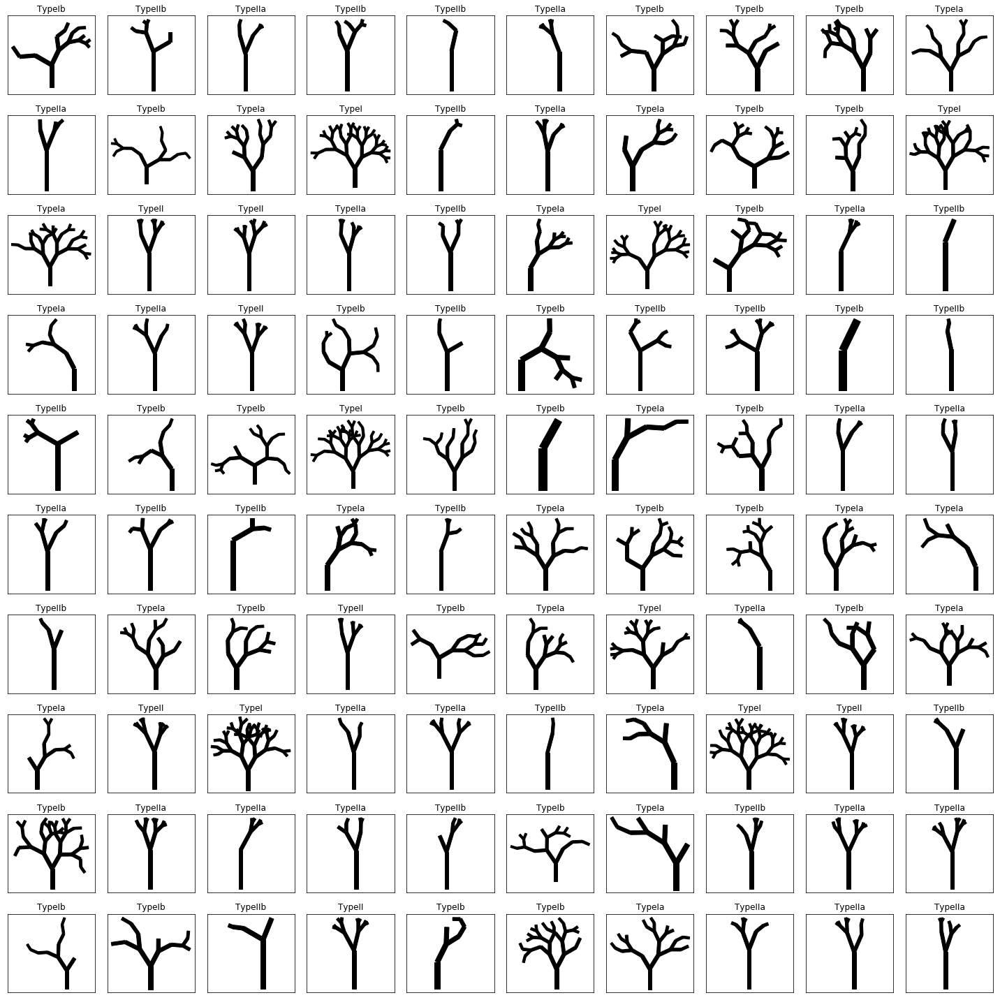

In [523]:
def drawTree(x1, y1, angle, length, width, depth, C):
    if depth:
        # Calculatre end position of segment
        x2 = x1 + np.cos(np.radians(angle)) * length
        y2 = y1 - np.sin(np.radians(angle)) * length
        # Plot
        w = (depth**2)/8
        rect = Rectangle((x1-(width/2), y1), width, length, color='k')
        t = mpl.transforms.Affine2D().rotate_deg_around(x1,y1,-angle-90) + plt.gca().transData
        rect.set_transform(t)
        plt.gca().add_patch(rect)
        # Randomise the angle & length changes
        rnd1 = np.random.random(4) - 0.5
        l1 = C['LENGTH_CHANGE'] + (rnd1[0] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        l2 = C['LENGTH_CHANGE'] + (rnd1[1] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        a1 = C['ANGLE_CHANGE']  + (rnd1[2] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        a2 = C['ANGLE_CHANGE']  + (rnd1[3] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        # Reduce split probability
        C['SPLIT_PROB']  = C['SPLIT_PROB'] * C['SPLIT_PROB_CHANGE']
        # Test right angle split
        rnd2 = np.random.random(4)
        if rnd2[0] < C['LARGE_ANGLE_PROB']: a1 = C['LARGE_ANGLE'] * rnd2[1]/np.abs(rnd2[1]) 
        if rnd2[2] < C['LARGE_ANGLE_PROB']: a2 = C['LARGE_ANGLE'] * rnd2[3]/np.abs(rnd2[3]) 
        # Draw two more branches
        rnd3 = np.random.random(2)
        if rnd3[0] < C['SPLIT_PROB']: drawTree(x2, y2, angle-a1, length*l1, width*C['WIDTH_CHANGE'], depth-1, copy.deepcopy(C))
        if rnd3[1] < C['SPLIT_PROB']: drawTree(x2, y2, angle+a2, length*l2, width*C['WIDTH_CHANGE'], depth-1, copy.deepcopy(C))


seed = 1
np.random.seed(seed)
plt.figure(figsize=(20,20))

for j in range(100):
    plt.subplot(10,10,j+1)
    i = np.random.choice(Is, p=Ps)
    C = Cs[i]
    N = Ns[i]
    drawTree(C['x0'], C['y0'], C['INITIAL_ANGLE'], C['INITIAL_LENGTH'], C['INITIAL_WIDTH'], C['DEPTH'], copy.deepcopy(C))
    plt.axis('equal')
    plt.tick_params(axis='both',which='both',bottom=False,left=False,labelbottom=False,labelleft=False)
    plt.title(N)
    
plt.tight_layout()
plt.show()

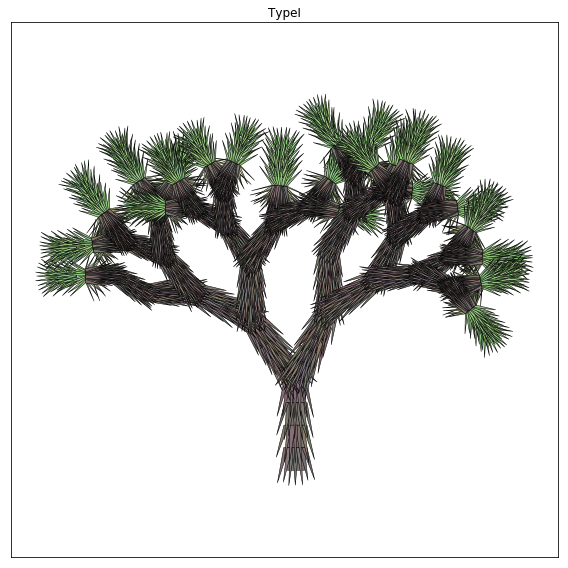

In [8]:
Z = {'zorder': 0}

def drawTree(x1, y1, angle, length, width, depth, C, Z):
    if depth:
        Z['zorder'] += 1
        # Calculatre end position of segment
        x2 = x1 + np.cos(np.radians(angle)) * length
        y2 = y1 - np.sin(np.radians(angle)) * length
        # Plot
        w = (depth**2)/8
        
        rect = Rectangle((x1-(width/2), y1), width, length, color=COL_BROWN, zorder=0)
        t = mpl.transforms.Affine2D().rotate_deg_around(x1,y1,-angle-90) + plt.gca().transData
        rect.set_transform(t)
        plt.gca().add_patch(rect)
        
        density = 2 + (2 * (1-(depth / C['DEPTH'])))
        max_angle = 40 * (1-(depth / C['DEPTH']))
        spikes0 = draw_spikes(x1,y1+(length*0.25),width,length*0.75,
                              spike_colour=COL_BROWN,
                              spike_direction=-1,
                              spike_length=2,
                              spike_max_angle=15,
                              spike_density_x=density,
                              spike_density_y=density,
                              spike_zorder=Z['zorder'])
        t0 = mpl.transforms.Affine2D().rotate_deg_around(x1,y1,-angle-90) + plt.gca().transData
        spikes0.set_transform(t0)
        plt.gca().add_collection(spikes0)
            
        # Randomise the angle & length changes
        rnd1 = np.random.random(4) - 0.5
        l1 = C['LENGTH_CHANGE'] + (rnd1[0] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        l2 = C['LENGTH_CHANGE'] + (rnd1[1] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        a1 = C['ANGLE_CHANGE']  + (rnd1[2] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        a2 = C['ANGLE_CHANGE']  + (rnd1[3] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        # Reduce split probability
        C['SPLIT_PROB']  = C['SPLIT_PROB'] * C['SPLIT_PROB_CHANGE']
        # Test right angle split
        rnd2 = np.random.random(4)
        if rnd2[0] < C['LARGE_ANGLE_PROB']: a1 = C['LARGE_ANGLE'] * rnd2[1]/np.abs(rnd2[1]) 
        if rnd2[2] < C['LARGE_ANGLE_PROB']: a2 = C['LARGE_ANGLE'] * rnd2[3]/np.abs(rnd2[3]) 
        # Draw two more branches
        rnd3 = np.random.random(2)
        if rnd3[0] < C['SPLIT_PROB']: drawTree(x2, y2, angle-a1, length*l1, width*C['WIDTH_CHANGE'], depth-1, copy.deepcopy(C), Z)
        if rnd3[1] < C['SPLIT_PROB']: drawTree(x2, y2, angle+a2, length*l2, width*C['WIDTH_CHANGE'], depth-1, copy.deepcopy(C), Z)
        # leaves
        if (rnd3[0] > C['SPLIT_PROB'] and rnd3[1] > C['SPLIT_PROB']) or depth==1:
            # At a terminal branch, draw the leaves
            # This is set at the same angle as the preceding branch (to avoid spikes at weird angles)
            # Green
            spikes1 = draw_spikes(x2,y2,width,max(length,C['INITIAL_LENGTH']/4),spike_zorder=Z['zorder'])
            t1 = mpl.transforms.Affine2D().rotate_deg_around(x2,y2,-angle-90) + plt.gca().transData
            spikes1.set_transform(t1)
            plt.gca().add_collection(spikes1)
            
            spikes2 = draw_spikes(x2,y2-(length*0.25),width,length*0.25,
                                  spike_max_angle=70,
                                  spike_direction=-1,
                                  spike_colour=COL_GREEN_YELLOW,
                                  spike_density_y=6,
                                  spike_zorder=Z['zorder'])
            t2 = mpl.transforms.Affine2D().rotate_deg_around(x2,y2,-angle-90) + plt.gca().transData
            spikes2.set_zorder(0)
            spikes2.set_transform(t2)
            plt.gca().add_collection(spikes2)       
          
            
# Cannot match examples above due to added randomness
# Need to either add leaves after, or deal with new randoms
seed = int(1000*np.random.random())
np.random.seed(seed)
i = np.random.choice(Is, p=Ps)
C = Cs[i]
N = Ns[i]

# Plot it 
plt.figure(figsize=(8,8))
drawTree(C['x0'], C['y0'], C['INITIAL_ANGLE'], C['INITIAL_LENGTH'], C['INITIAL_WIDTH'], C['DEPTH'], copy.deepcopy(C), Z)
plt.axis('equal')
plt.tick_params(axis='both',which='both',bottom=False,left=False,labelbottom=False,labelleft=False)
plt.title(N)
plt.tight_layout()
plt.show()

## 4a - quick look at combining the textures - example of preliminary tests

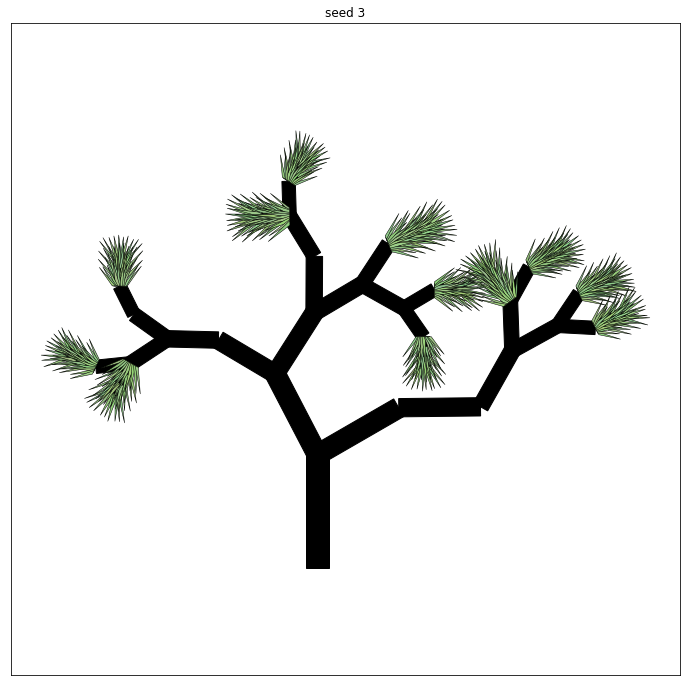

In [471]:
C1 = {'x0':0,
    'y0':0,
    'INITIAL_LENGTH':5,
    'LENGTH_CHANGE':0.8,
    'LENGTH_VARY_PROP':0.2,
    'INITIAL_ANGLE':-90,
    'ANGLE_CHANGE':30,
    'ANGLE_VARY_PROP':0.4,
    'SPLIT_PROB':0.9,
    'SPLIT_PROB_CHANGE': 0.9,
    'INITIAL_WIDTH':1,
    'WIDTH_CHANGE':0.9,
    'DEPTH':7}

def drawTree(x1, y1, angle, length, width, depth, C):
    if depth:
        # Calculatre end position of segment
        x2 = x1 + np.cos(np.radians(angle)) * length
        y2 = y1 - np.sin(np.radians(angle)) * length
        # Plot
        w = (depth**2)/8
        rect = Rectangle((x1-(width/2), y1), width, length, color='k')
        t = mpl.transforms.Affine2D().rotate_deg_around(x1,y1,-angle-90) + plt.gca().transData
        rect.set_transform(t)
        plt.gca().add_patch(rect)
        # Randomise the angle & length changes
        rnd1 = np.random.random(4) - 0.5
        l1 = C['LENGTH_CHANGE'] + (rnd1[0] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        l2 = C['LENGTH_CHANGE'] + (rnd1[1] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        a1 = C['ANGLE_CHANGE']  + (rnd1[2] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        a2 = C['ANGLE_CHANGE']  + (rnd1[3] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        # Reduce split probability
        C['SPLIT_PROB']  = C['SPLIT_PROB'] * C['SPLIT_PROB_CHANGE']
        # Test right angle split
        r = np.random.random(4)
        if r[0] < 0.2: a1 = 60 * r[1]/np.abs(r[1]) 
        if r[2] < 0.2: a2 = 60 * r[3]/np.abs(r[3]) 
        # Draw two more branches
        rnd2 = np.random.random(2)
        if rnd2[0] < C['SPLIT_PROB']: drawTree(x2, y2, angle-a1, length*l1, width*C['WIDTH_CHANGE'], depth-1, copy.deepcopy(C))
        if rnd2[1] < C['SPLIT_PROB']: drawTree(x2, y2, angle+a2, length*l2, width*C['WIDTH_CHANGE'], depth-1, copy.deepcopy(C))
        
        # leaves
        if (rnd2[0] > C['SPLIT_PROB'] and rnd2[1] > C['SPLIT_PROB']) or depth==1:
            spikes1 = draw_spikes(x1,y1,width,length,spike_zorder=10)
            t1 = mpl.transforms.Affine2D().rotate_deg_around(x1,y1,-angle-90) + plt.gca().transData
            spikes1.set_transform(t1)
            plt.gca().add_collection(spikes1)
            
plt.figure(figsize=(12,12))
seed = 3
np.random.seed(seed)
drawTree(C1['x0'], C1['y0'], C1['INITIAL_ANGLE'], C1['INITIAL_LENGTH'], C1['INITIAL_WIDTH'], C1['DEPTH'], copy.deepcopy(C1))


plt.axis('equal')
plt.title('seed {}'.format(seed))
plt.tick_params(axis='both',which='both',bottom=False,left=False,labelbottom=False,labelleft=False)
plt.show()

## 5 - Forests

In this section, we will use our function to draw Joshua Forests among interesting backgrounds. To save time and energy, we will make use of this nice [landscape generator](https://github.com/s23tang/landscape-generator) which uses the midpoint displacement method to generate mountainous landscapes.

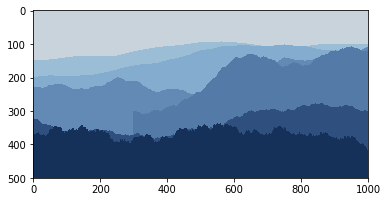

In [92]:
sys.path.insert(0, '/path/to/landscape-generator/')
from landscape.draw import LandscapeImage, Dimensions, BlueHills
from landscape.geometry import Point, XOrderedSegment
hills = BlueHills(Dimensions(1000, 500))
hills.render()
plt.imshow(np.asarray(hills.image))

We really just need a simple version of this, with maybe a couple of colours to simulate the Californian deserts.

In [202]:
Z = {'zorder': 0}

def drawTree(x1, y1, angle, length, width, depth, C, Z):
    if depth:
        Z['zorder'] += 1
        # Calculatre end position of segment
        x2 = x1 + np.cos(np.radians(angle)) * length
        y2 = y1 - np.sin(np.radians(angle)) * length
        # Plot
        w = (depth**2)/8
        
        rect = Rectangle((x1-(width/2), y1), width, length, color=(0,0,0), zorder=Z['zorder'])
        t = mpl.transforms.Affine2D().rotate_deg_around(x1,y1,-angle-90) + plt.gca().transData
        rect.set_transform(t)
        plt.gca().add_patch(rect)
        
        density = 2 + (2 * (1-(depth / C['DEPTH'])))
        max_angle = 40 * (1-(depth / C['DEPTH']))
        spikes0 = draw_spikes(x1,y1+(length*0.25),width,length*0.75,
                              spike_colour=(0,0,0),
                              spike_direction=-1,
                              spike_length=2,
                              spike_max_angle=15,
                              spike_density_x=density,
                              spike_density_y=density,
                              spike_zorder=Z['zorder'])
        t0 = mpl.transforms.Affine2D().rotate_deg_around(x1,y1,-angle-90) + plt.gca().transData
        spikes0.set_transform(t0)
        plt.gca().add_collection(spikes0)
            
        # Randomise the angle & length changes
        rnd1 = np.random.random(4) - 0.5
        l1 = C['LENGTH_CHANGE'] + (rnd1[0] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        l2 = C['LENGTH_CHANGE'] + (rnd1[1] * C['LENGTH_CHANGE'] * C['LENGTH_VARY_PROP'])
        a1 = C['ANGLE_CHANGE']  + (rnd1[2] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        a2 = C['ANGLE_CHANGE']  + (rnd1[3] * C['ANGLE_CHANGE']  * C['ANGLE_VARY_PROP'])
        # Reduce split probability
        C['SPLIT_PROB']  = C['SPLIT_PROB'] * C['SPLIT_PROB_CHANGE']
        # Test right angle split
        rnd2 = np.random.random(4)
        if rnd2[0] < C['LARGE_ANGLE_PROB']: a1 = C['LARGE_ANGLE'] * rnd2[1]/np.abs(rnd2[1]) 
        if rnd2[2] < C['LARGE_ANGLE_PROB']: a2 = C['LARGE_ANGLE'] * rnd2[3]/np.abs(rnd2[3]) 
        # Draw two more branches
        rnd3 = np.random.random(2)
        if rnd3[0] < C['SPLIT_PROB']: drawTree(x2, y2, angle-a1, length*l1, width*C['WIDTH_CHANGE'], depth-1, copy.deepcopy(C), Z)
        if rnd3[1] < C['SPLIT_PROB']: drawTree(x2, y2, angle+a2, length*l2, width*C['WIDTH_CHANGE'], depth-1, copy.deepcopy(C), Z)
        # leaves
        if (rnd3[0] > C['SPLIT_PROB'] and rnd3[1] > C['SPLIT_PROB']) or depth==1:
            # At a terminal branch, draw the leaves
            # This is set at the same angle as the preceding branch (to avoid spikes at weird angles)
            # Green
            spikes1 = draw_spikes(x2,y2,width,max(length,C['INITIAL_LENGTH']/4),spike_zorder=Z['zorder'], spike_colour=(0,0,0))
            t1 = mpl.transforms.Affine2D().rotate_deg_around(x2,y2,-angle-90) + plt.gca().transData
            spikes1.set_transform(t1)
            plt.gca().add_collection(spikes1)
            
            spikes2 = draw_spikes(x2,y2-(length*0.25),width,length*0.25,
                                  spike_max_angle=70,
                                  spike_direction=-1,
                                  spike_colour=(0,0,0),
                                  spike_density_y=6,
                                  spike_zorder=Z['zorder'])
            t2 = mpl.transforms.Affine2D().rotate_deg_around(x2,y2,-angle-90) + plt.gca().transData
            spikes2.set_zorder(0)
            spikes2.set_transform(t2)
            plt.gca().add_collection(spikes2) 

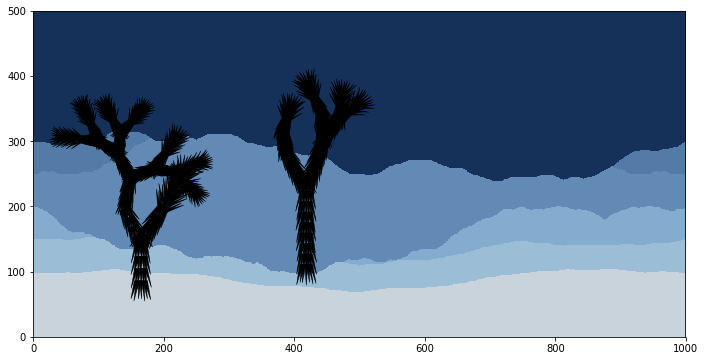

In [91]:
'''
# twi pallette
c1 = (68,63,110)
c2 = (191,78,100)
c3 = (224,109,86)
c4 = (232,171,44)
c5 = (240,215,105)
'''

# Altos
csky = (58,73,108)
c1 = (204,169,168)
c2 = (118,118,148)
c3 = (130,117,147)
c4 = (100,100,142)

c5 = (135,98,92) #land farthest
c6 = (113,83,77) #land closest

d = Dimensions(1000, 500)
l = LandscapeImage(d, (200, 211, 220))

l1 = l.draw_hill(Point(0, 400), Point(1000, 400), (155, 189, 214), 30, 1.2, 10)
l2 = l.draw_hill(Point(0, 350), Point(1000, 350), (132, 172, 207), 40, 1.2, 6)
l3 = l.draw_hill(Point(0, 300), Point(1000, 300), (98, 138, 181), 80, 1, 8)
l4 = l.draw_hill(Point(0, 250), Point(1000, 250), (84, 123, 167), 80, 1, 8)
l5 = l.draw_hill(Point(0, 150), Point(1000, 150), (47, 79, 126), 50, 0.8, 9)
l6 = l.draw_hill(Point(0, 200), Point(1000, 200), (22, 49, 89), 50, 0.8, 6)

plt.figure(figsize=(12,6))
plt.imshow(np.asarray(l.image))

'''
for i in range(5):
    seed = int(1000*np.random.random())
    np.random.seed(seed)
    i = np.random.choice(Is, p=Ps)
    C = Cs[i]
    N = Ns[i]  
    drawTree(int(np.random.random()*1000),
             int(np.random.random()*100),
             C['INITIAL_ANGLE'],
             C['INITIAL_LENGTH']*5,
             C['INITIAL_WIDTH']*5,
             C['DEPTH'],
             copy.deepcopy(C),
             Z)
'''

smallest_tree_coords = [[l.x, 500-l.y] for l in l6]
for i in range(10):
    i = 2#np.random.choice(Is, p=Ps)
    C = Cs[i]
    N = Ns[i]
    rnd_spot_on_hill = smallest_tree_coords[int(len(smallest_tree_coords)*np.random.random())]
    C['x0'] = rnd_spot_on_hill[0]
    C['y0'] = rnd_spot_on_hill[1]-(np.random.random()*20)
    '''drawTree(C['x0'],
             C['y0'],
             C['INITIAL_ANGLE'],
             C['INITIAL_LENGTH']*3,
             C['INITIAL_WIDTH']*3,
             C['DEPTH'],
             copy.deepcopy(C),
             Z)'''

smallest_tree_coords = [[l.x, 500-l.y] for l in l1]
for i in range(2):
    i = np.random.choice(Is, p=Ps)
    C = Cs[i]
    N = Ns[i]
    rnd_spot_on_hill = smallest_tree_coords[int(len(smallest_tree_coords)*np.random.random())]
    C['x0'] = rnd_spot_on_hill[0]
    C['y0'] = rnd_spot_on_hill[1]-(np.random.random()*50)
    drawTree(C['x0'],
             C['y0'],
             C['INITIAL_ANGLE'],
             C['INITIAL_LENGTH']*15,
             C['INITIAL_WIDTH']*15,
             C['DEPTH'],
             copy.deepcopy(C),
             Z)
#for l in l6: plt.plot(l.x, 500-l.y, 'ko', zorder=10)
#for l in l2: plt.plot(l.x, 500-l.y, 'ko', zorder=10)
#for l in l3: plt.plot(l.x, 500-l.y, 'ko', zorder=10)
#for l in l4: plt.plot(l.x, 500-l.y, 'ko', zorder=10)
#for l in l5: plt.plot(l.x, 500-l.y, 'ko', zorder=10)
    
plt.ylim(0,500)
plt.show()

### Test how to do this better

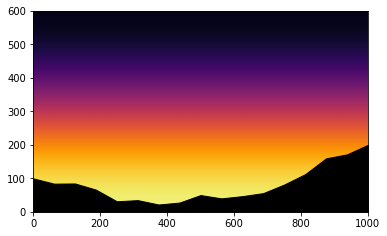

In [124]:
def draw_hill(start, end, displacement_factor, roughness, iterations):
    segment = XOrderedSegment(Point(start[0],start[1]), Point(end[0],end[1]))
    segment.iterative_displacement(displacement_factor, roughness, iterations)
    sx, sy = [p.x for p in segment.points], [p.y for p in segment.points]
    return sx, sy

xmin, xmax = 0, 1000
ymin, ymax = 0, 600
plt.figure()
plt.xlim(xmin,xmax)
plt.ylim(ymin,ymax)
plt.imshow([[0, 0],[1, 1]], cmap=plt.cm.inferno, interpolation='bicubic', extent=plt.xlim()+plt.ylim())

sx, sy = draw_hill((0,100), (1000,200), 100, 1.2, 4)
plt.fill_between(sx, sy, y2=0, color='k')

plt.show()


### Gradient sky and simpler hills, ala Alto's Odyssey

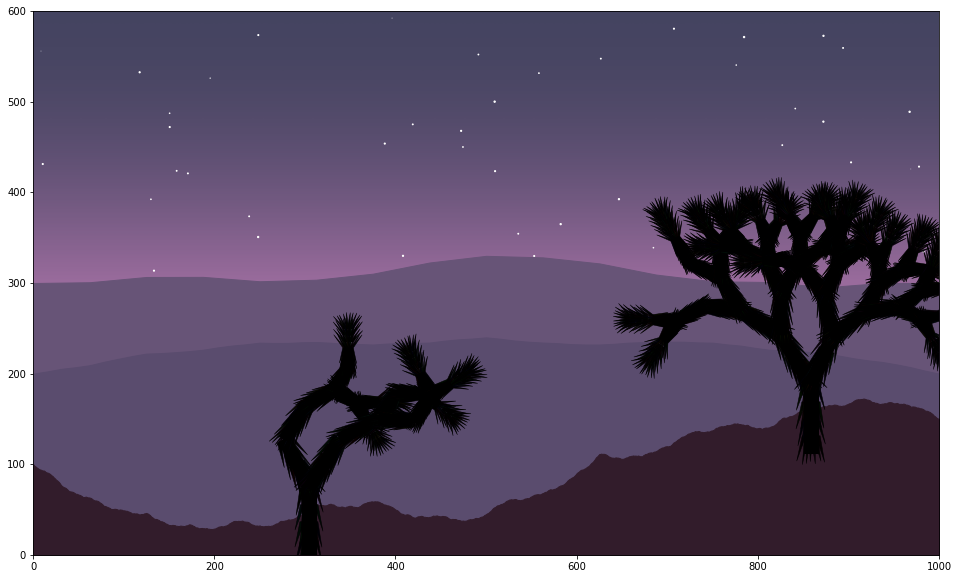

In [398]:
from matplotlib.colors import ListedColormap

sky_top = np.array([62, 65, 92])/256
sky_bottom = np.array([154, 108, 157])/256
sky_bright = np.array([241,159,173])/256

hills_back = np.array([103, 84, 119])/256
hills_mid = np.array([94, 77, 112])/256
hills_front = np.array([90, 76, 110])/256
foreground = np.array([50, 28, 43])/256

# Create a custom gradient colour map for the background
N = 256
vals = np.ones((N, 4))
vals[:, 0] = np.hstack([np.linspace(sky_top[0], sky_bottom[0], 128), np.ones(128)*sky_bottom[0]])
vals[:, 1] = np.hstack([np.linspace(sky_top[1], sky_bottom[1], 128), np.ones(128)*sky_bottom[1]])
vals[:, 2] = np.hstack([np.linspace(sky_top[2], sky_bottom[2], 128), np.ones(128)*sky_bottom[2]])
newcmp = ListedColormap(vals)

# Produce some hills
sx1, sy1 = draw_hill((0,300), (1000,300), 30, 1.2, 4)
sx2, sy2 = draw_hill((0,200), (1000,200), 40, 1.5, 6)
sx3, sy3 = draw_hill((0,100), (1000,150), 80, 1, 10)

xmin, xmax = 0, 1000
ymin, ymax = 0, 600
plt.figure(figsize=(20,10))
plt.xlim(xmin,xmax)
plt.ylim(ymin,ymax)
plt.imshow([[0, 0],[1, 1]], cmap=newcmp, interpolation='bicubic', extent=plt.xlim()+plt.ylim(), zorder=0)

num_stars = 100
starx = np.random.random(num_stars) * xmax
stary = np.random.random(num_stars) * ymax
plt.scatter(starx, stary, s=(2*np.random.random(num_stars)), c='w', zorder=1)

plt.fill_between(sx1, sy1, y2=0, color=hills_back)
plt.fill_between(sx2, sy2, y2=0, color=hills_front)
plt.fill_between(sx3, sy3, y2=0, color=foreground)

for i in range(2):
    i = np.random.choice(Is, p=Ps)
    C = Cs[i]
    N = Ns[i]
    
    hill_position = int(len(sx3)*np.random.random())
    rnd_spot_on_hill = [sx3[hill_position], sy3[hill_position]]
    C['x0'] = rnd_spot_on_hill[0]
    C['y0'] = rnd_spot_on_hill[1]-50
    drawTree(C['x0'],
             C['y0'],
             C['INITIAL_ANGLE'],
             C['INITIAL_LENGTH']*15,
             C['INITIAL_WIDTH']*15,
             C['DEPTH'],
             copy.deepcopy(C),
             Z)
    
plt.show()

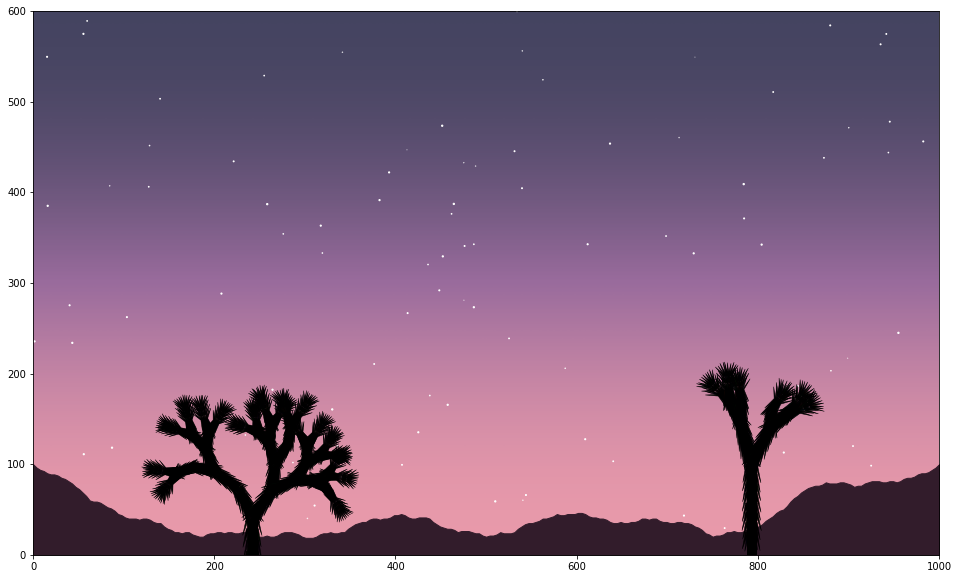

In [788]:
from matplotlib.colors import ListedColormap

sky_top = np.array([62, 65, 92])/256
sky_bottom = np.array([154, 108, 157])/256
sky_bright = np.array([241,159,173])/256

hills_back = np.array([103, 84, 119])/256
hills_mid = np.array([94, 77, 112])/256
hills_front = np.array([90, 76, 110])/256
foreground = np.array([50, 28, 43])/256

# Create a custom gradient colour map for the background
N = 256
vals = np.ones((N, 4))
vals[:, 0] = np.hstack([np.linspace(sky_top[0], sky_bottom[0], 128), np.linspace(sky_bottom[0], sky_bright[0], 128)]) #np.ones(128)*sky_bottom[0]])
vals[:, 1] = np.hstack([np.linspace(sky_top[1], sky_bottom[1], 128), np.linspace(sky_bottom[1], sky_bright[1], 128)]) #np.ones(128)*sky_bottom[1]])
vals[:, 2] = np.hstack([np.linspace(sky_top[2], sky_bottom[2], 128), np.linspace(sky_bottom[2], sky_bright[2], 128)]) #np.ones(128)*sky_bottom[2]])
newcmp = ListedColormap(vals)

# Produce some hills
sx1, sy1 = draw_hill((0,200), (1000,200), 30, 1.2, 4)
sx2, sy2 = draw_hill((0,150), (1000,150), 40, 1.5, 6)
sx3, sy3 = draw_hill((0,100), (1000,100), 80, 1, 8)

xmin, xmax = 0, 1000
ymin, ymax = 0, 600
plt.figure(figsize=(20,10))
plt.xlim(xmin,xmax)
plt.ylim(ymin,ymax)
plt.imshow([[0, 0],[1, 1]], cmap=newcmp, interpolation='bicubic', extent=plt.xlim()+plt.ylim(), zorder=0)

num_stars = 100
starx = np.random.random(num_stars) * xmax
stary = np.random.random(num_stars) * ymax
plt.scatter(starx, stary, s=(2*np.random.random(num_stars)), c='w', zorder=1)

#plt.fill_between(sx1, sy1, y2=0, color=hills_back)
#plt.fill_between(sx2, sy2, y2=0, color=hills_front)
plt.fill_between(sx3, sy3, y2=0, color=foreground)

for i in range(2):
    i = np.random.choice(Is, p=Ps)
    C = Cs[i]
    N = Ns[i]
    
    hill_position = int(len(sx3)*np.random.random())
    rnd_spot_on_hill = [sx3[hill_position], sy3[hill_position]]
    C['x0'] = rnd_spot_on_hill[0]
    C['y0'] = rnd_spot_on_hill[1]-30
    drawTree(C['x0'],
             C['y0'],
             C['INITIAL_ANGLE'],
             C['INITIAL_LENGTH']*10,
             C['INITIAL_WIDTH']*10,
             C['DEPTH'],
             copy.deepcopy(C),
             Z)
    
    
plt.show()

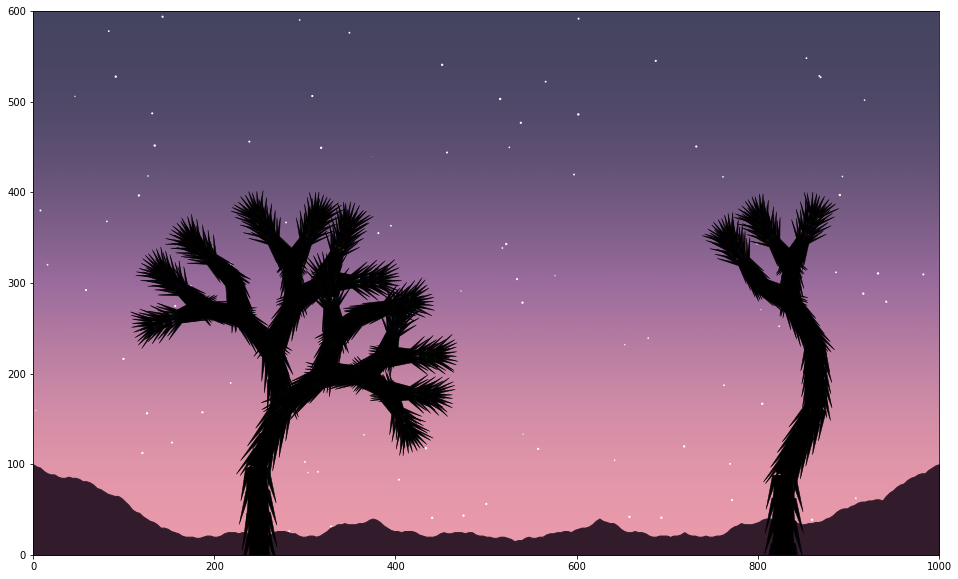

In [784]:
from matplotlib.colors import ListedColormap

sky_top = np.array([62, 65, 92])/256
sky_bottom = np.array([154, 108, 157])/256
sky_bright = np.array([241,159,173])/256

hills_back = np.array([103, 84, 119])/256
hills_mid = np.array([94, 77, 112])/256
hills_front = np.array([90, 76, 110])/256
foreground = np.array([50, 28, 43])/256

# Create a custom gradient colour map for the background
N = 256
vals = np.ones((N, 4))
vals[:, 0] = np.hstack([np.linspace(sky_top[0], sky_bottom[0], 128), np.linspace(sky_bottom[0], sky_bright[0], 128)]) #np.ones(128)*sky_bottom[0]])
vals[:, 1] = np.hstack([np.linspace(sky_top[1], sky_bottom[1], 128), np.linspace(sky_bottom[1], sky_bright[1], 128)]) #np.ones(128)*sky_bottom[1]])
vals[:, 2] = np.hstack([np.linspace(sky_top[2], sky_bottom[2], 128), np.linspace(sky_bottom[2], sky_bright[2], 128)]) #np.ones(128)*sky_bottom[2]])
newcmp = ListedColormap(vals)

# Produce some hills
sx1, sy1 = draw_hill((0,200), (1000,200), 30, 1.2, 4)
sx2, sy2 = draw_hill((0,150), (1000,150), 40, 1.5, 6)
sx3, sy3 = draw_hill((0,100), (1000,100), 80, 1, 8)

xmin, xmax = 0, 1000
ymin, ymax = 0, 600
plt.figure(figsize=(20,10))
plt.xlim(xmin,xmax)
plt.ylim(ymin,ymax)
plt.imshow([[0, 0],[1, 1]], cmap=newcmp, interpolation='bicubic', extent=plt.xlim()+plt.ylim(), zorder=0)

num_stars = 100
starx = np.random.random(num_stars) * xmax
stary = np.random.random(num_stars) * ymax
plt.scatter(starx, stary, s=(2*np.random.random(num_stars)), c='w', zorder=1)

#plt.fill_between(sx1, sy1, y2=0, color=hills_back)
#plt.fill_between(sx2, sy2, y2=0, color=hills_front)
plt.fill_between(sx3, sy3, y2=0, color=foreground)

num_trees = 2
for j in range(num_trees):
    i = j#np.random.choice(Is, p=Ps)
    C = Cs[i]
    N = Ns[i]
    
    rnd_spot_on_hill = [np.random.choice(np.array_split(sx3, num_trees)[j]), np.random.choice(np.array_split(sy3, num_trees)[j])]
    C['x0'] = rnd_spot_on_hill[0]
    C['y0'] = rnd_spot_on_hill[1]-30
    drawTree(C['x0'],
             C['y0'],
             C['INITIAL_ANGLE']+((np.random.random()-0.5)*10),
             C['INITIAL_LENGTH']*20,
             C['INITIAL_WIDTH']*20,
             C['DEPTH'],
             copy.deepcopy(C),
             Z)
    
    
plt.show()